Below is the code for recognising digits on an LCD display surrounded by orange postit notes. Skip to the last section to actually use this code _Putting it all together_.

**REMEMBER TO EXPAND THE LIBRARIES SECTION WHEN RUNNING ALL TO ALLOW ACCESS TO THE DRIVE**

Also remember to change the variable below to the path of your video.

Instructions:

- Change `VIDEO_PATH` to the video path from your google drive
- Click Runtime > Run all
- Expand the *Libraries* section and follow the instructions.
- Scroll to the last section *Putting it all together* and check the frames as they are being processed.
- When evaluation of that section finishes (this will take a while) in your google drive there should be a .csv file in the folder of your video.

In [ ]:

# Go to drive.google.com and find the video. Change this path after My Drive/...
VIDEO_PATH = "/content/1.mp4"
# THESE ARE FOR DEBUGGING:
TEST_FRAME = 0 # This is not useful for creating the csv
RELEASE = True

# Libraries

The main library we will be interacting with is OpenCV which is compatible with numpy.

In [ ]:
import cv2
import numpy as np
from math import ceil,floor
import itertools as it
from functools import (reduce,lru_cache)

# Colab needs special handing of imshow.
from google.colab.patches import cv2_imshow

from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


# Reading the frames

Large videos will take up too much memory so we should be iterating on the frames. For a colab notebook we will just read 100 frames and be done with it.

frame at time(sec):  0.0


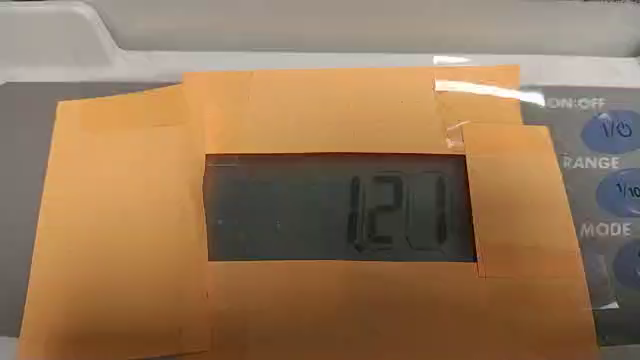

In [ ]:

def video_frames(video_path):
  cap = cv2.VideoCapture(video_path)
  frames = []
  fps = float(cap.get(cv2.CAP_PROP_FPS))
  is_open = cap.isOpened()
  frame_num = 0
  while is_open and len(frames) < 1000:
    is_open, frame = cap.read()
    if is_open:
      yield (frame_num/fps,frame)
      frame_num += 1

def nth(iterable, n, default=None):
  "Returns the nth item or a default value"
  return next(it.islice(iterable, n, None), default)


time,frame = nth(video_frames(VIDEO_PATH),TEST_FRAME)
print("frame at time(sec): ", time)
cv2_imshow(frame)


# Contours

These classes are the data abstraction for dealing with contours.

In [ ]:
class Contour(object):
  def points(self):
    raise NotImplemented

  def bbox(self):
    raise NotImplemented

  def dist(self,other,transform):
    self_pts = np.float32(self.points())
    other_pts = np.float32(other.points())
    ys = np.subtract.outer(self_pts[:,1],other_pts[:,1])
    xs = np.subtract.outer(self_pts[:,0],other_pts[:,0])
    return np.sqrt(np.min(np.sum(transform(np.dstack((xs,ys))) ** 2,axis=2)))

  def center(self):
    (l,r),(t,b) = self.bbox()
    return ((l + r)/2,(t + b)/2)

  def bbox_image(self,on_image=None,image=None):
    (l,r),(t,b) = self.bbox()
    img = self.image if image is None else image
    if on_image is not None:
      img = on_image(img)
    return img[t:b,l:r]

  def bbox_mask(self,on_mask=None):
    return self.bbox_image(on_image=on_mask,image=self.mask)

  def avg_color(self,on_image=None,on_mask=None):
    mask = MaskImage(self.bbox_mask(on_mask=on_mask))
    masked = ColorImage(self.bbox_image(on_image=on_image)).as_greyscale().with_mask(mask)
    return masked.average()

  def coavg_color(self):
    return self.avg_color(on_mask=np.invert)

def approx(c):
  peri = cv2.arcLength(c, True)
  return cv2.approxPolyDP(c, 0.005 * peri, True)

class ContourForest(Contour):
  @classmethod
  def from_image_mask(cls,image,mask):
    cnts,hierarchy = \
      cv2.findContours(mask, cv2.RETR_TREE, cv2.CHAIN_APPROX_NONE)
    trees = [ContourTree(c,i,image,mask) for i,c in enumerate(cnts)]
    for t in trees:
      t.initialize(hierarchy[0],trees)

    return cls(sorted(trees,key=lambda x:x.center()[0]),image,mask)

  def __init__(self,trees,image,mask):
    assert type(trees) == list
    self.trees = trees
    self.image = image
    self.mask = mask

  def new_trees(self,trees):
    return ContourForest(trees,self.image,self.mask)

  def show(self,on_image=None):
    cntrs = []
    for c in self.trees:
      cntrs.append(c.contour)
      cntrs += [c0.contour for c0 in c.total_children()]

    img = self.image.copy()
    if on_image is not None:
      img = on_image(img)

    cv2_imshow(cv2.drawContours(BaseImage.as_color(img).copy(),cntrs,-1,(0,255,0)))

  def numbers_forest(self,*args,**kw):
    return self.new_trees(list(self._drop_children(
        [c for c in self.trees if c.is_number(*args,**kw)])))

  def _drop_children(self, trees):
    for ci in trees:
      if all((ci not in cj.children for cj in trees)):
        yield ci

  def bbox(self):
    left,right,bot,top = None,None,None,None
    for c in self.trees:
      (l,r),(t,b) = c.bbox()
      left = min(l,left) if left is not None else l
      bot = max(b,bot) if bot is not None else b
      top = min(t,top) if top is not None else t
      right = max(r,right) if right is not None else r

    return ((left,right),(top,bot))

  def area(self):
    return sum((c.area() for c in self.trees))

  def _split_dist(self,trans,thres):
    # We assume the trees are ordered.
    ret = self.new_trees([self.trees[0]])
    rest = self.new_trees([])
    for c in self.trees[1:]:
      if ret.dist(c,trans) < thres:
        ret.append(c)
      else:
        rest.append(c)

    return (ret,rest)

  def __iter__(self):
    return iter(self.trees)

  def dist_groups(self,trans,thres=50):
    rest = self.new_trees(self.trees)
    while rest.trees:
      grp,rest = rest._split_dist(trans,thres)
      yield grp

  def points(self):
    return np.concatenate([t.points() for t in self.trees]).reshape(-1,2)

  def append(self,tree):
    self.trees.append(tree)

  def __len__(self):
    return len(self.trees)

  def __getitem__(self,i):
    if type(i) is int:
      return self.trees[i]
    slice_ = i
    return self.new_trees(self.trees[slice_])

class ContourTree(Contour):
  def __init__(self,contour,id,image,mask):
    self.contour = contour
    self.image = image
    self.mask = mask
    self.id = id
    self.initialized = False
    self.children = None
    self.__number_param = None

  def initialize(self,hierarchy,forest):
    if self.children is not None: return
    self.children = []
    self.next,prev,child,parent = hierarchy[self.id]

    while child > -1:
      forest[child].initialize(hierarchy,forest)
      self.children.append(forest[child])
      child = forest[child].next
      if child == self.id: raise Exception("oos")

  def points(self):
    return self.contour.reshape((-1,2))

  def area(self):
    area = cv2.contourArea(self.contour)
    for c in self.children:
      area -= c.area()
    return area

  def arc_length(self):
    arc = cv2.arcLength(self.contour,True)
    for c in self.children:
      arc += c.arc_length()
    return arc

  def total_children(self):
    for c in self.children:
      yield c
      for cc in c.total_children():
        yield cc

  def bbox(self):
    cnt = self.contour
    l = cnt[:,:,0].min()
    r = cnt[:,:,0].max()
    t = cnt[:,:,1].min()
    b = cnt[:,:,1].max()
    return ((l,r),(t,b))

  def _number_param(self):
    if self.__number_param is not None:
      return self.__number_param

    l = self.arc_length()
    if l == 0:
      self.__number_param = float("inf")
      return self.__number_param

    self.__number_param = self.area()/l
    return self.__number_param

  # 4 and 7 are magic numbers.
  def is_number(self,min_thresh=3.5,max_thresh=7):
    p = self._number_param()
    num_children = [c for c in self.total_children() if c.is_number()]
    a = self.area()
    h,w = self.mask.shape
    ret = min_thresh < p  \
      and p < max_thresh \
      and np.sum(self.coavg_color()) - np.sum(self.avg_color()) > 10 \
      and len(num_children) <= 2
    return ret


# Image abastraction

Some class abstractions for our images. Mostly for showing, converting and threshholding.

In [ ]:
class BaseImage(object):
  @staticmethod
  def as_color(arr_image):
    if len(arr_image.shape) == 2:
      return cv2.cvtColor(arr_image, cv2.COLOR_GRAY2BGR)
    assert len(arr_image.shape) == 3
    assert arr_image.shape[2] == 3
    return arr_image

  def width(self):
    return self.image.shape[0]

  def height(self):
    return self.image.shape[1]

  def show(self):
    cv2_imshow(self.as_color().image)

  def blurred(self,radius=5):
    diam = 2 * radius + 1
    return self.__class__(cv2.GaussianBlur(self.image,(diam,diam),radius/2))


class GreyImage(BaseImage):
  def __init__(self,image):
    self.image = image

  def as_color(self):
    return ColorImage(cv2.cvtColor(self.image, cv2.COLOR_GRAY2BGR))

  def as_greyscale(self):
    return self

  def otsu_thresh(grey):
    blurred = self.blurred(2)
    ret,img = cv2.threshold(blurred.image,0,255,cv2.THRESH_BINARY+cv2.THRESH_OTSU)
    return MaskImage(img)

  def naive_thresh(grey,th=128):
    blurred = self.blurred(2)
    ret,img = cv2.threshold(blurred.image,th,255,cv2.THRESH_BINARY)
    return MaskImage(img)

  def adaptive_thresh(self):
    blurred = self.blurred(2)
    rad = self.height() // 20
    rad = rad if rad % 2 else rad + 1
    return MaskImage(cv2.adaptiveThreshold(blurred.image,255,cv2.ADAPTIVE_THRESH_MEAN_C,cv2.THRESH_BINARY,rad,3))

  def with_mask(self,mask):
    assert isinstance(mask,MaskImage)
    return MaskedGreyImage(self.image,mask.image)

class MaskedGreyImage(BaseImage):
  def __init__(self,image,mask=None):
    if mask is not None:
      self.image = np.ma.array(image,mask=(mask != 0))
    else:
      self.image = image
    assert isinstance(self.image,np.ma.MaskedArray),self.image.__class__

  def filled(self,fill=None):
    if fill is None:
      fill = self.image.mean()
    return GreyImage(self.image.filled(fill))

  def average(self):
    return np.average(self.image)

  def normalize(self):
    """Can accept masked"""
    pixvals = self.image
    ret = np.uint8((pixvals - pixvals.min()) / (pixvals.max()-pixvals.min()) * 255)
    return MaskedGreyImage(ret)

class ColorImage(BaseImage):
  def __init__(self,image):
    assert len(image.shape) == 3, "Looks like a greyscale or a mask..."
    assert image.shape[2] == 3, "Expected three channels for a color image."
    self.image = image

  def kmeans_masks(self,K=2):
    vectorized = self.image.copy().reshape((-1,3))
    vectorized = np.float32(vectorized)
    criteria = (cv2.TERM_CRITERIA_EPS + cv2.TERM_CRITERIA_MAX_ITER, 10, 1.0)
    attempts=10
    ret,labels,centers=cv2.kmeans(vectorized,K,None,criteria,attempts,cv2.KMEANS_PP_CENTERS)
    centers = np.uint8(centers)
    res = centers[labels.flatten()]
    return MultiMaskImage(res.reshape(self.image.shape),centers)

  def as_color(self):
    return self

  def as_greyscale(self):
    return GreyImage(cv2.cvtColor(self.image,cv2.COLOR_BGR2GRAY))

  def drop_orange(self,K=5):
    # select the least orange mask (it will probably not be a postit)
    (color,mask) = min(self.kmeans_masks(K),key = lambda x: x[0][2])
    norm = self.as_greyscale().with_mask(mask).normalize()
    return norm.filled(0)

  def object_mask(self):
    return self.drop_orange().adaptive_thresh()

  def contour_forest(self):
    return ContourForest.from_image_mask(self.image,self.object_mask().image)

class MultiMaskImage(BaseImage):
  def __init__(self,image,centers):
    self.image = image
    self.centers = centers

  def keys(self):
    return list(self.centers)

  def __getitem__(self,color_center):
    if color_center not in self.centers:
      raise IndexError("Center not in masks. Use .keys()")

    mask_3channel = self.image != color_center
    mask = np.min(mask_3channel,axis=2) # Color comparison yields 3 bools. They all need to be True.
    return MaskImage(mask)

  def __iter__(self):
    for c in self.centers:
      yield (c,self[c])

class MaskImage(GreyImage):
  """A mask image is a binary color image.

  For convenience we will be using uint8 though"""

  def __init__(self,mask_image):
    self.image = mask_image

  def as_greyscale(self):
    return GreyImage(self.image)

  def blurred(self):
    return GreyImage(super().blurred().image)

  def apply_mask(self,img,fill):
    arr = np.ma.array(img,mask=(mask != 0))
    if fill is None:
      fill = np.mean(arr,axis=(0,1))
    return img.__class__(arr.filled(fill))

  def invert(self):
    return MaskImage(np.invert(self.image))


# Short example with numbers



## Naive layer

First try naively using the heuristic in `.numbers_forest()` to use the area and circumferance of a contour to infer if it's a number.

**TODO:** The number 8 fails to passthis test

Numbers forest naive: 3


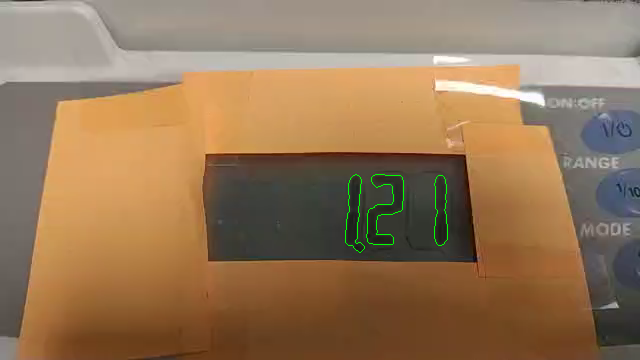

In [ ]:
cntr_forest = ColorImage(frame).contour_forest()
numbers_forest_naive = cntr_forest.numbers_forest()
print("Numbers forest naive:", len(numbers_forest_naive))
numbers_forest_naive.show()
assert len(numbers_forest_naive) >= 3

### Positional layer

We regard objects that are close together in the vertical axis to be probably-numbers. From those that pass the naive layer group them together with regard to their distance and choose the group that has the most objects

Numbers forest: 3


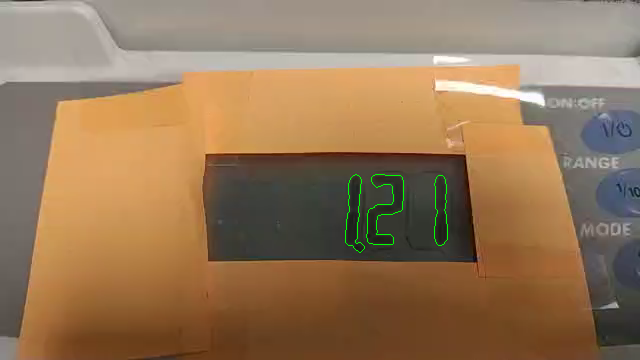

In [ ]:
def trans_v(p):
  return np.power(p,3,out=p,where=np.array([False,True]))

grps = list(numbers_forest_naive.dist_groups(trans_v,50))
assert len(grps) > 0
numbers_forest = max(grps,key=len)
print("Numbers forest:", len(numbers_forest))
numbers_forest.show()

### Separate the numbers

Each number is possibly (and probably) split into different objects which will be extremely close to each other. Group the objects again, this time being more eager to split horizontally.

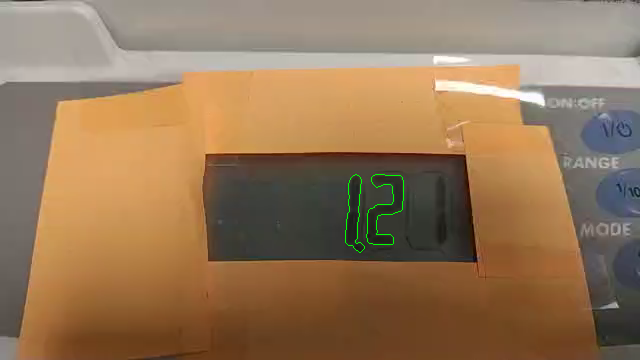

Dist 0-1:  29791.0


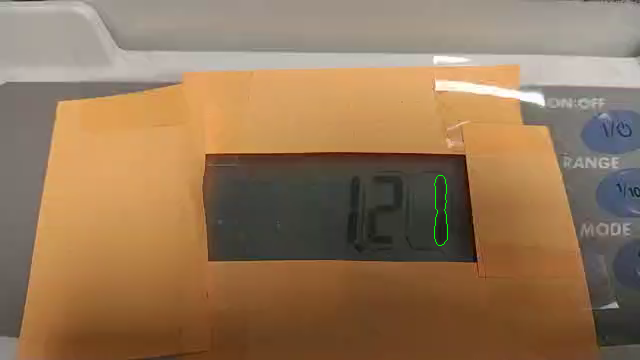

IndexError: ignored

In [ ]:
def trans_h(p):
  return np.power(p,3,out=p,where=np.array([True,False]))

nums = list(numbers_forest.dist_groups(trans_h,thres=50))
nums[0].show()
print("Dist 0-1: ",nums[0].dist(nums[1], trans_h))
nums[1].show()
print("Dist 1-2: ",nums[1].dist(nums[2], trans_h))
nums[2].show()

# Recognize the number

The following code recognises numbers from contours. Set `SHOW_IMAGES` to `True` to get more information during execution.

In [ ]:
SHOW_IMAGES = not RELEASE
# TILT=0
TILT=.2
V_SECTIONS = 7
H_SECTIONS = 3.5


def num_mask(fn):
  def mk_mask(shape,tilt=TILT):
    h,w = shape
    return np.array([[(255 if call_fn(fn,i,j,w,h,tilt) else 0) for i in range(w)]
                      for j in range(h)],
                    dtype=np.uint8)
  return mk_mask

def call_fn(f,i,j,w,h,tilt):
  k = - w * tilt
  a =   (w - k) / w
  b = - k / h
  c = k
  new_i = a * i + b * j + c
  if new_i < 0 or new_i > w:
    return False
  return f(new_i,j,w,h)

@num_mask
def one_mask(i,j,w,h):
  return j > h * (V_SECTIONS+.5) / (2 * V_SECTIONS) or j < h * (V_SECTIONS-.5) / (2 * V_SECTIONS)

@num_mask
def no_line(i,j,w,h):
  return False
@num_mask
def top_line(i,j,w,h):
  return j < h / V_SECTIONS
@num_mask
def bot_line(i,j,w,h):
  return j > (V_SECTIONS - 1)*h / V_SECTIONS
@num_mask
def top_left_line(i,j,w,h):
  return j < h / 2 and i < w/H_SECTIONS
@num_mask
def top_right_line(i,j,w,h):
  return j < h / 2 and i > (H_SECTIONS - 1)*w/H_SECTIONS
@num_mask
def bot_right_line(i,j,w,h):
  return j > h / 2 and i > (H_SECTIONS-1) *w/H_SECTIONS
@num_mask
def bot_left_line(i,j,w,h):
  return j > h / 2 and i < w/H_SECTIONS
@num_mask
def mid_line(i,j,w,h):
  return j > floor(V_SECTIONS/2.) * h / V_SECTIONS and j < ceil(V_SECTIONS/2.)*h/V_SECTIONS

M = [
  [top_line,top_right_line,top_left_line,bot_left_line,bot_right_line,bot_line]
  , [one_mask]
  , [top_line,top_right_line,mid_line,bot_left_line,bot_line]
  , [top_line,top_right_line,mid_line,bot_right_line,bot_line]
  , [top_left_line,top_right_line,mid_line,bot_right_line]
  , [top_line,top_left_line,mid_line,bot_right_line,bot_line]
  , [top_line,top_left_line,mid_line,bot_left_line,bot_right_line,bot_line]
  , [top_line,top_right_line,bot_right_line]
  , [top_line,top_right_line,top_left_line,mid_line,bot_left_line,bot_right_line,bot_line]
  , [top_line,top_right_line,top_left_line,mid_line,bot_right_line,bot_line]]

def check_mask(img,mask):
  masked_ratio = (img & mask).sum() / img.sum()
  unmasked_ratio = (img | mask).sum() / mask.sum() - 1
  if SHOW_IMAGES:
    print("Num:")
    cv2_imshow(img)
    print("Mask:")
    cv2_imshow(mask)
    print("Masked: ")
    cv2_imshow(img&mask)
    print ("Masked ratio (>.9): ", masked_ratio)
    print ("Unasked ratio (<.1): ", unmasked_ratio)

  return masked_ratio > .9 and unmasked_ratio < .1


def eight_mask(sh):
  return top_line(sh) \
    | bot_line(sh) \
    | mid_line(sh) \
    | top_left_line(sh)\
    | top_right_line(sh)  \
    | bot_left_line(sh) \
    | bot_right_line(sh)

ALL_LINES = [top_line
             ,top_left_line,top_right_line
             ,mid_line
             ,bot_left_line,bot_right_line
             ,bot_line]

NUM_ASSOC = [(0,[1,1,1,-1,1,1,1])
            # ,(1,None)
            ,(2,[1,-1,1,1,1,-1,1])
            ,(3,[1,-1,1,1,-1,1,1])
            ,(4,[-1,1,1,1,-1,1,-1])
            ,(5,[1,1,-1,1,-1,1,1])
            ,(6,[1,1,-1,1,1,1,1])
            ,(7,[1,-1,1,-1,-1,1,0])
            ,(8,[1,1,1,1,1,1,1])
            ,(9,[1,1,1,1,-1,1,1])
]

def check_num(n,img):
  sh = img.shape
  mask = no_line(sh)
  for line_mask in M[n]:
    mask |= line_mask(sh)
  return check_mask(img,mask)

def empty_space_mask(sh,tilt=TILT):
  mask = np.ones(sh,dtype=np.uint8) * 255
  for l in ALL_LINES:
    mask &= np.invert(l(sh,tilt))
  return mask


def infer_tilt(image):
  h = image.shape[0]
  w = image.shape[1]
  img = image[:h//5,:]
  rows = np.any(img, axis=1)
  cols = np.any(img, axis=0)
  rmin, rmax = np.where(rows)[0][[0, -1]]
  cmin, cmax = np.where(cols)[0][[0, -1]]
  rtilt = cmin/w
  ltilt = (cmax - w) /w
  return rtilt if rtilt > 0.001 else ltilt

def to_number(contour):
  img = contour.bbox_mask(on_mask=lambda x: np.invert(x))
  tilt = infer_tilt(img)
  prob_on = [None] * len(ALL_LINES)
  empty_mask = empty_space_mask(img.shape,tilt)
  is_one_mask = one_mask(img.shape,tilt)
  one_score = (img & is_one_mask).sum() / is_one_mask.sum()

  baseline = (img & empty_mask).sum() / empty_mask.sum()
  for i,line_mask in enumerate(ALL_LINES):
    mask = line_mask(img.shape,tilt)
    prob_on[i] = (mask & img).sum() / mask.sum()


  dist_from_05 = [p-0.5 for p in prob_on]
  nscores = [(1,one_score - 0.5)]
  for (n,arr) in NUM_ASSOC:
    nscores.append((n,sum([i*d for i,d in zip(arr,dist_from_05)])/float(len(arr))))
  if SHOW_IMAGES:
    print("image:")
    cv2_imshow(img)
    print("empty mask: ")
    cv2_imshow(empty_mask)
    print("one mask: ")
    cv2_imshow(is_one_mask)
    cv2_imshow(one_mask(img.shape,tilt))
    print("Baseline: ", baseline)
    print("Line probs: ", prob_on)
    print("Num probs: ", nscores)
    print("Tilt:",tilt)


  return max(nscores,key=lambda x:x[1])

def crop_num_img(num):
  return num.bbox_image(on_image=lambda x: np.invert(thresh(x)))

def check_each_num(img):
  # Each number should not be subsumed by a previous one.
  for i in [2,3,5,4,7,0,6,9,8,1]:
    if check_num(i,img):
      return i
  return None

def cntr_to_num(n_cntr,frame):
  return check_each_num(crop_num_img(n_cntr,frame))

to_number(nums[0])
# [to_number(n) for n in nums]
# check_num(7,crop_num_img(nums[2],frame))
# cntr_to_num(nums[2],frame)
# call_fn(lambda i,j,w,l: (i,j),0,0,100,100)



(2, 0.07767796912910882)

# Putting it all together

This is the actual program that transforms the images

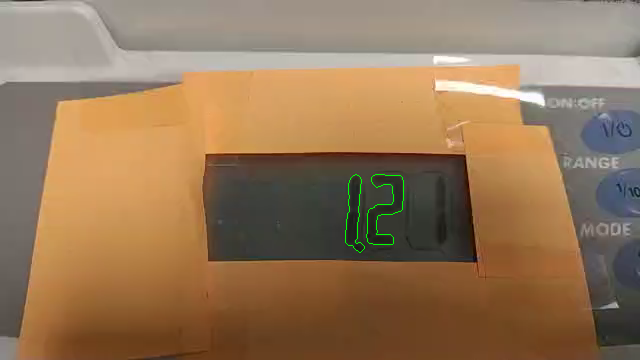

fr# 0 time: 0.0 num: 0.02 certainty: 0.07767796912910882


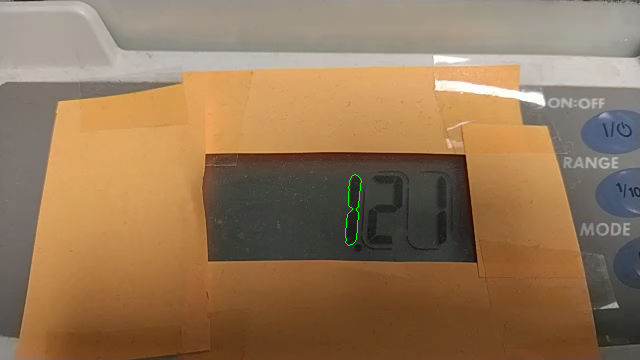

fr# 301 time: 10.030280251255997 num: 0.01 certainty: 0.2379227053140096


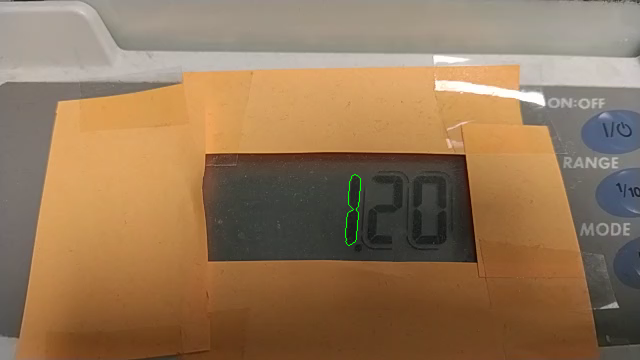

fr# 601 time: 20.027237312308486 num: 0.01 certainty: 0.32849239280774556


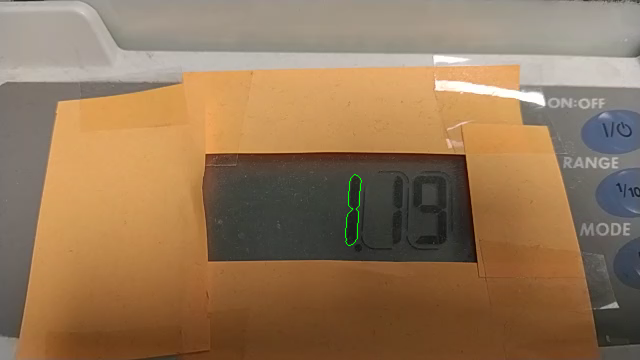

fr# 901 time: 30.024194373360974 num: 0.01 certainty: 0.2926208651399491


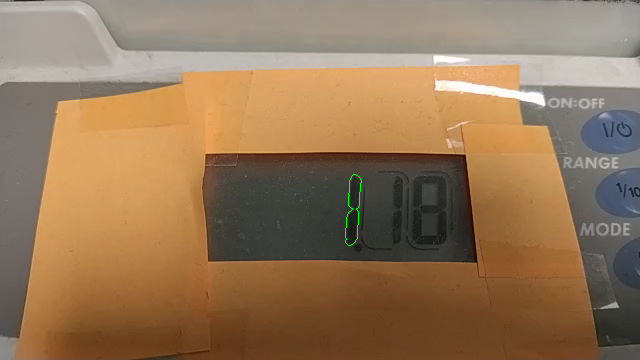

fr# 1201 time: 40.02115143441346 num: 0.01 certainty: 0.30025445292620867


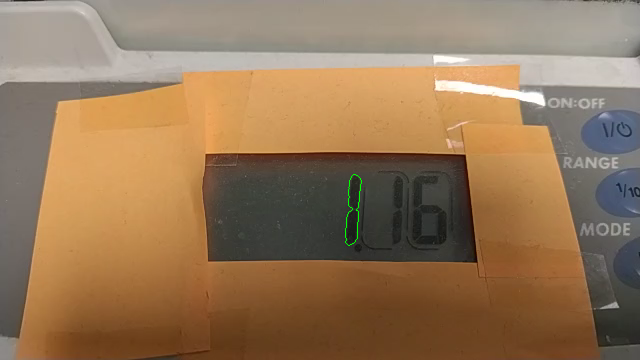

fr# 1501 time: 50.01810849546595 num: 0.01 certainty: 0.24879227053140096


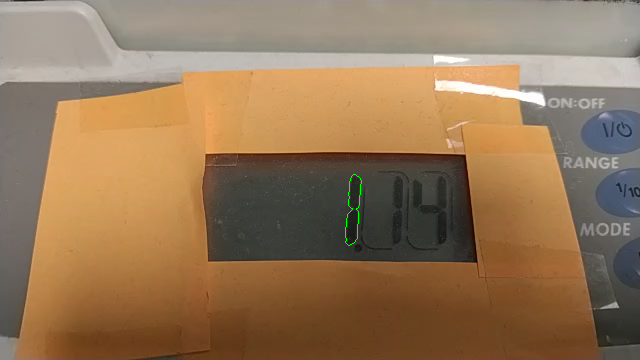

fr# 1801 time: 60.01506555651844 num: 0.01 certainty: 0.2926208651399491


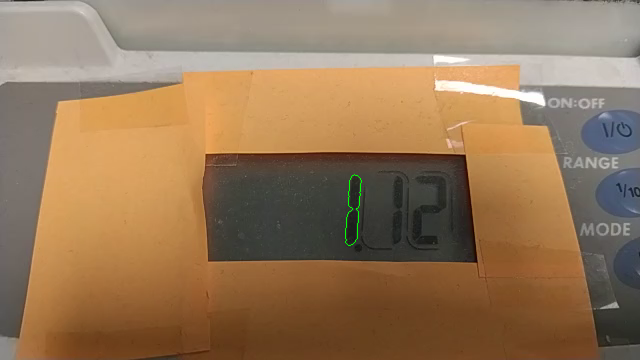

fr# 2101 time: 70.01202261757092 num: 0.01 certainty: 0.29898218829516543


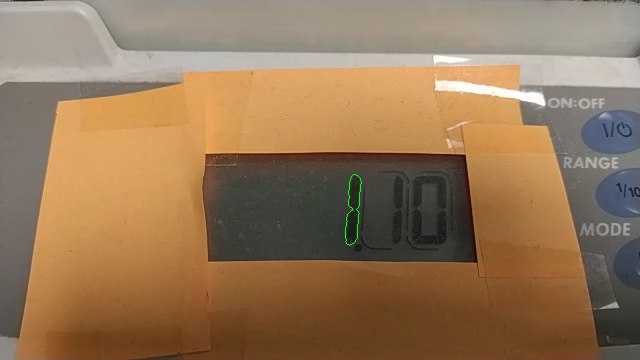

fr# 2401 time: 80.00897967862342 num: 0.01 certainty: 0.2913486005089059


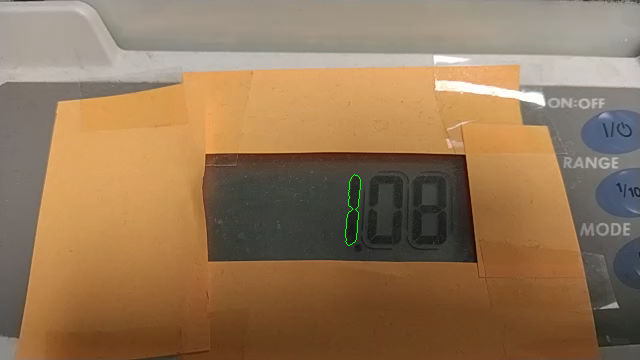

fr# 2701 time: 90.0059367396759 num: 0.01 certainty: 0.3132780082987552


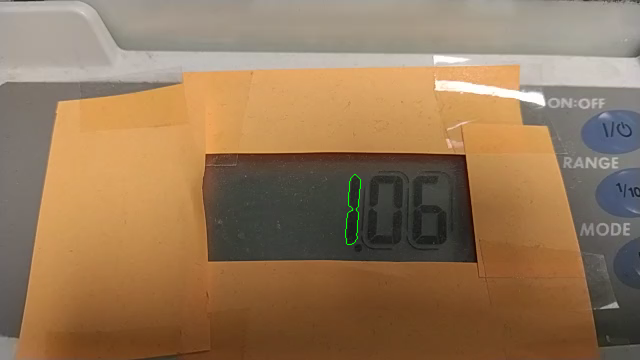

fr# 3001 time: 100.00289380072839 num: 0.01 certainty: 0.3262068965517242


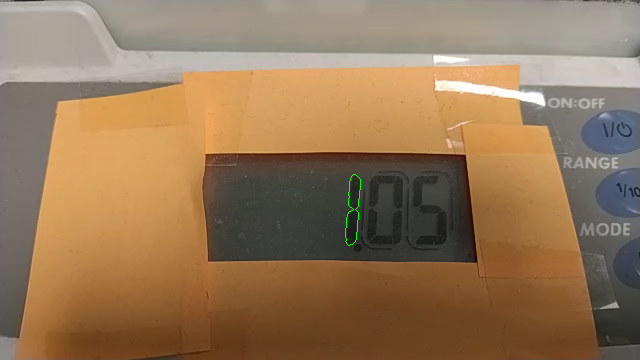

fr# 3302 time: 110.03317405198439 num: 0.01 certainty: 0.3229598893499308


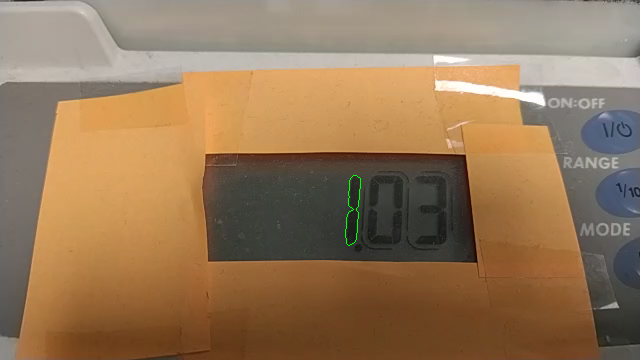

fr# 3602 time: 120.03013111303687 num: 0.01 certainty: 0.32068965517241377


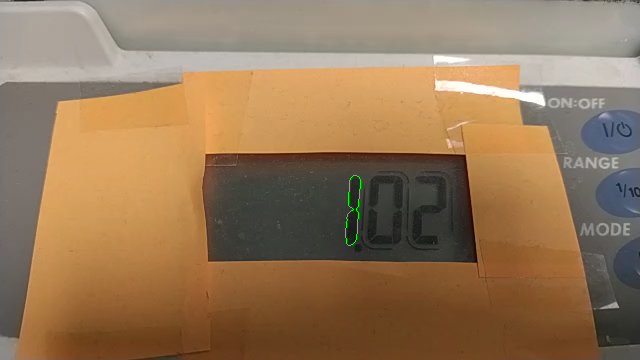

fr# 3902 time: 130.02708817408936 num: 0.01 certainty: 0.32482758620689656


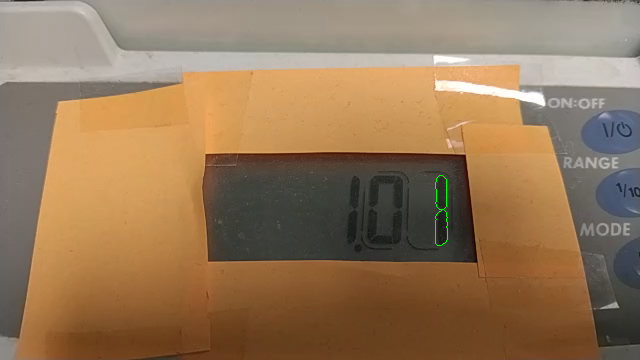

fr# 4202 time: 140.02404523514184 num: 0.01 certainty: 0.35174825174825175


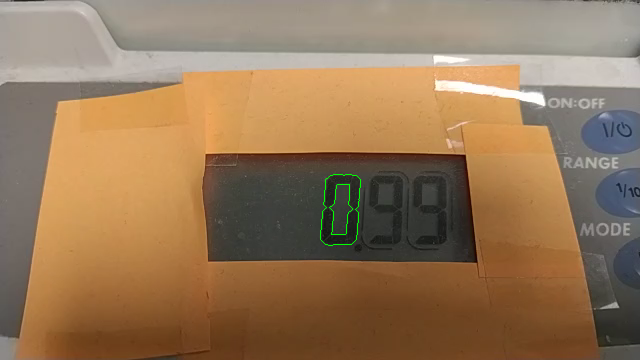

fr# 4502 time: 150.02100229619435 num: 0.0 certainty: 0.3108675916051209


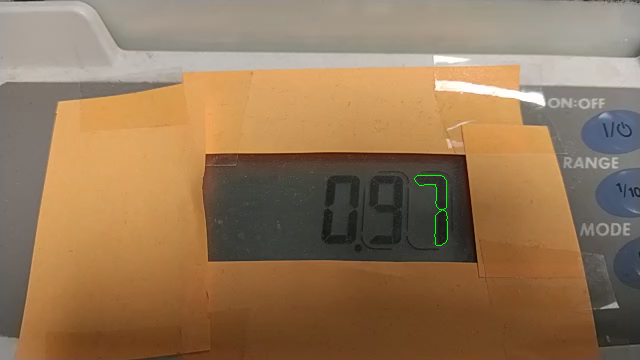

fr# 4802 time: 160.01795935724684 num: 0.07 certainty: 0.2851265683201802


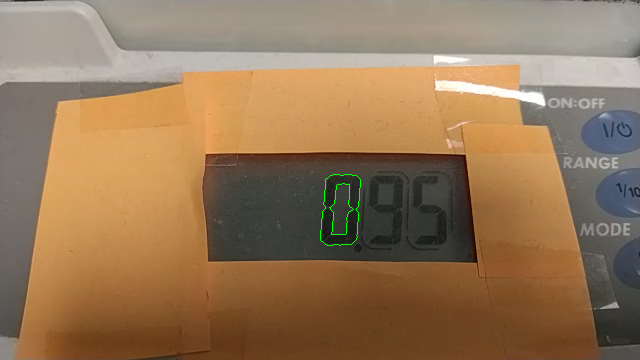

fr# 5102 time: 170.01491641829932 num: 0.0 certainty: 0.31428949171977677


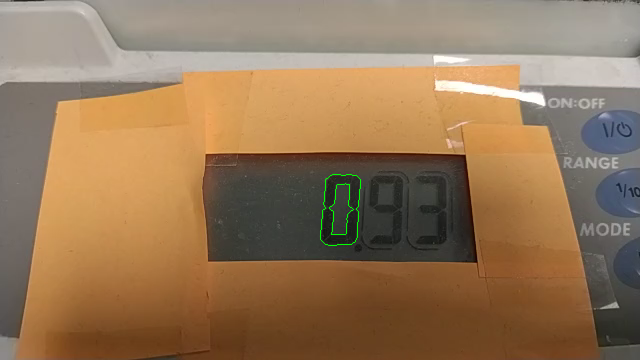

fr# 5402 time: 180.0118734793518 num: 0.0 certainty: 0.3138244118128935


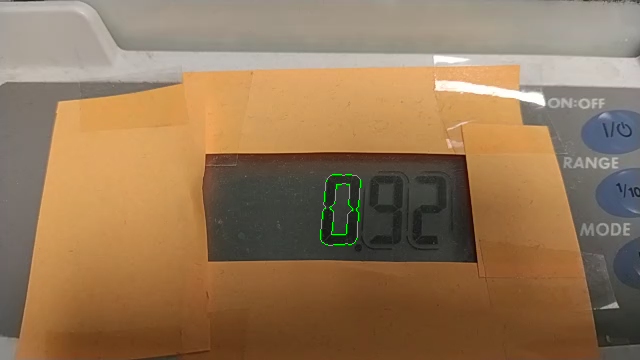

fr# 5702 time: 190.0088305404043 num: 0.0 certainty: 0.3066841826359089


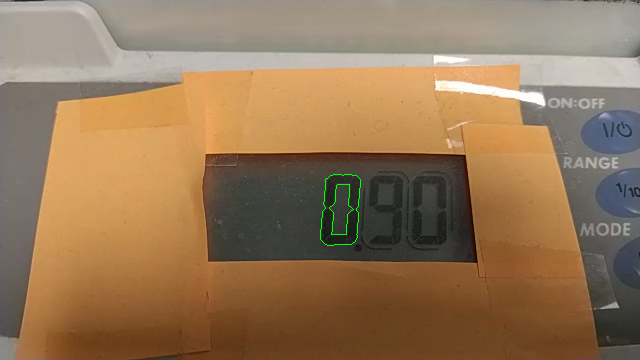

fr# 6002 time: 200.00578760145677 num: 0.0 certainty: 0.31330402832583115


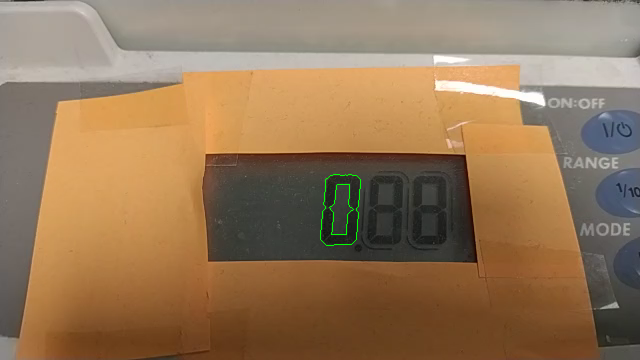

fr# 6302 time: 210.0027446625093 num: 0.0 certainty: 0.31062461910534855


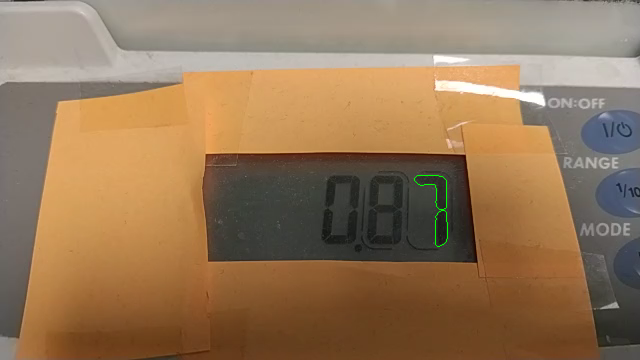

fr# 6603 time: 220.03302491376527 num: 0.07 certainty: 0.26741135297268276


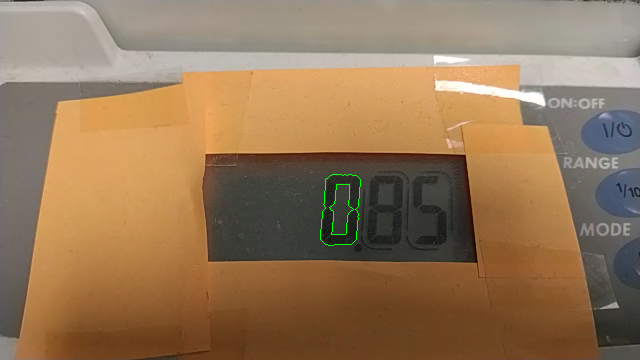

fr# 6903 time: 230.02998197481776 num: 0.0 certainty: 0.30971356885263945


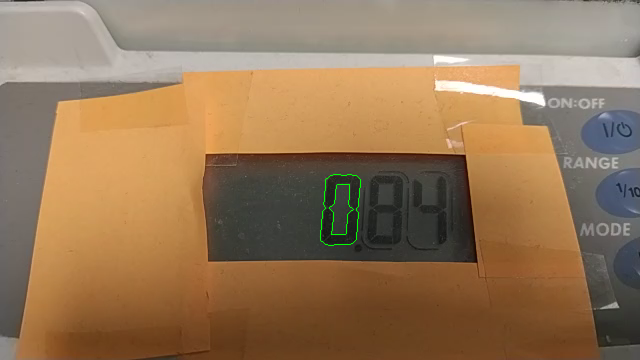

fr# 7203 time: 240.02693903587024 num: 0.0 certainty: 0.30896562569631936


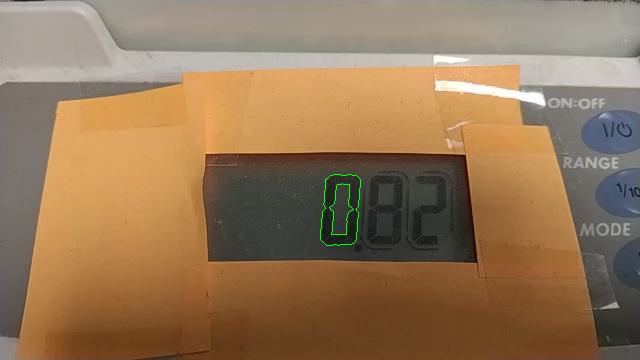

fr# 7503 time: 250.02389609692273 num: 0.0 certainty: 0.3155348313119804


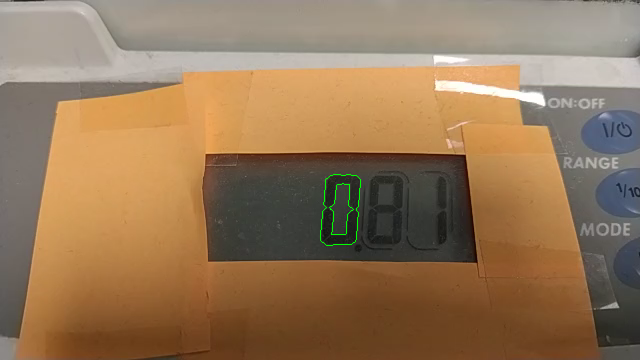

fr# 7803 time: 260.02085315797524 num: 0.0 certainty: 0.3139488025742198


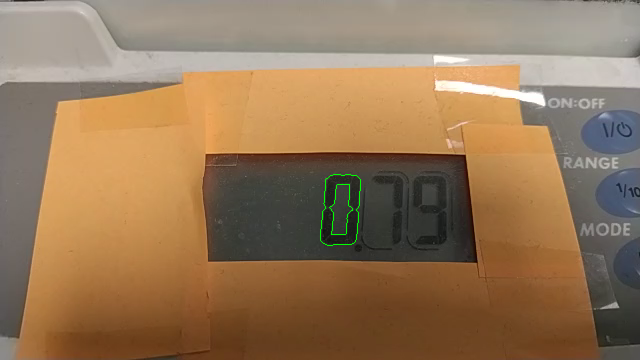

fr# 8103 time: 270.0178102190277 num: 0.0 certainty: 0.3146349706733092


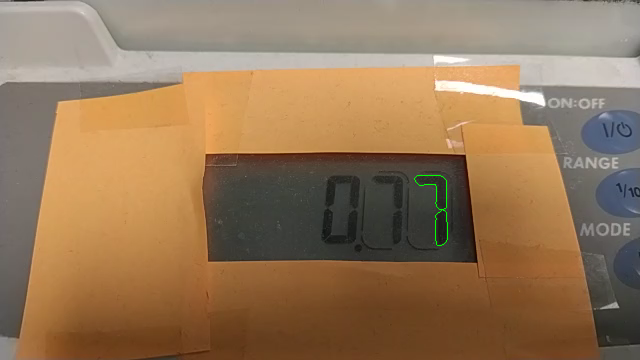

fr# 8403 time: 280.0147672800802 num: 0.07 certainty: 0.2752043244757209


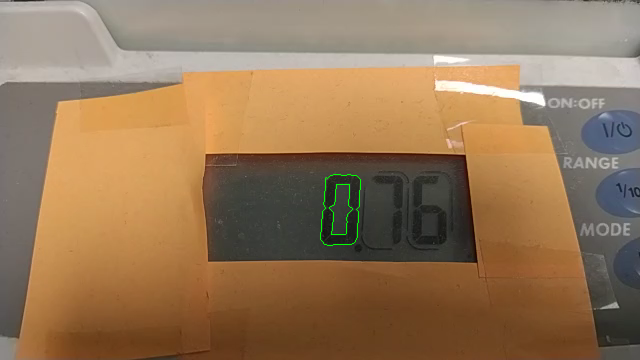

fr# 8703 time: 290.01172434113266 num: 0.0 certainty: 0.3065892926982841


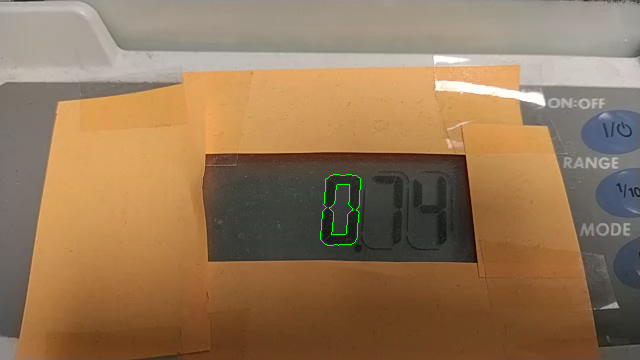

fr# 9003 time: 300.0086814021852 num: 0.0 certainty: 0.3118014650884514


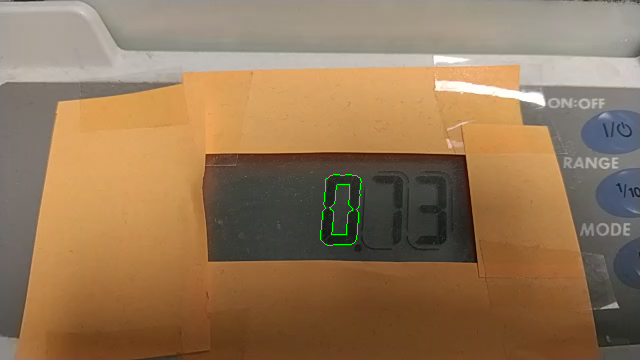

fr# 9303 time: 310.0056384632377 num: 0.0 certainty: 0.303218734876435


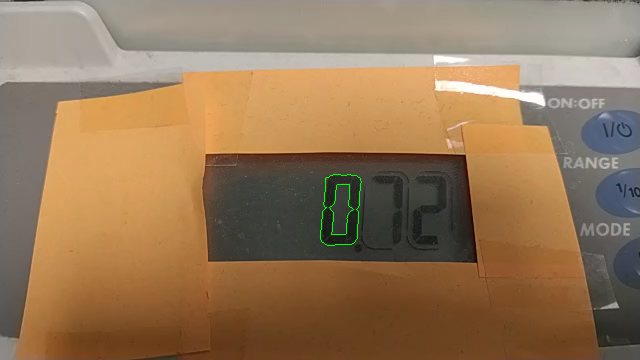

fr# 9603 time: 320.00259552429014 num: 0.0 certainty: 0.29224192873812754


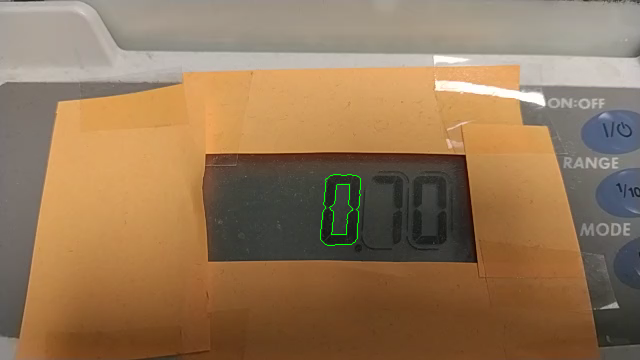

fr# 9904 time: 330.03287577554613 num: 0.0 certainty: 0.3125731943156846


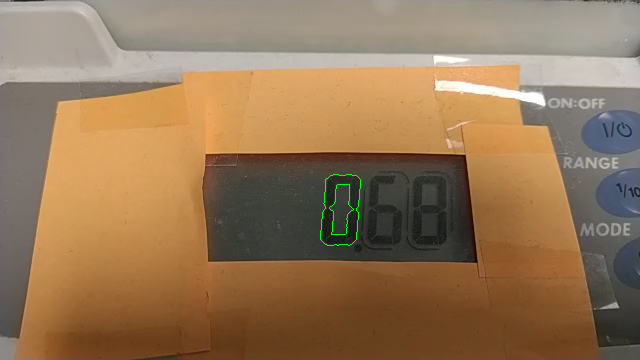

fr# 10204 time: 340.02983283659864 num: 0.0 certainty: 0.31150639273562514


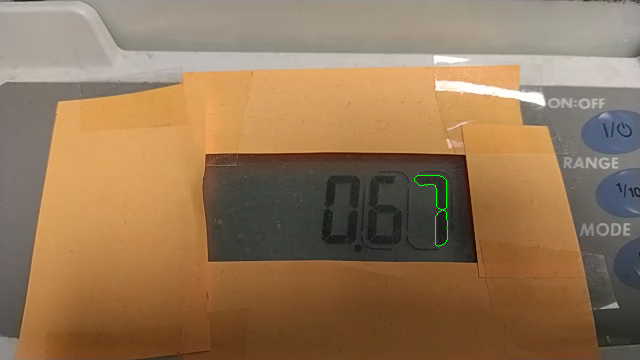

fr# 10504 time: 350.02678989765116 num: 0.07 certainty: 0.23918553516353164


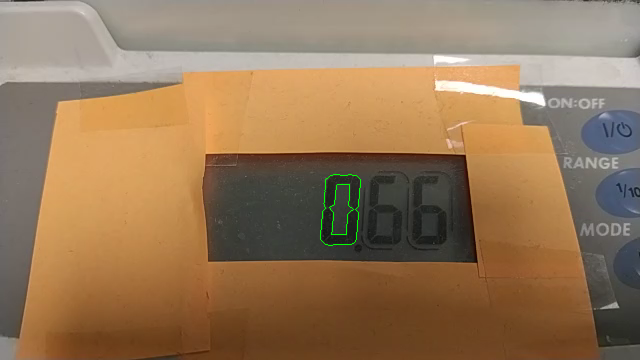

fr# 10804 time: 360.0237469587036 num: 0.0 certainty: 0.29591649113527513


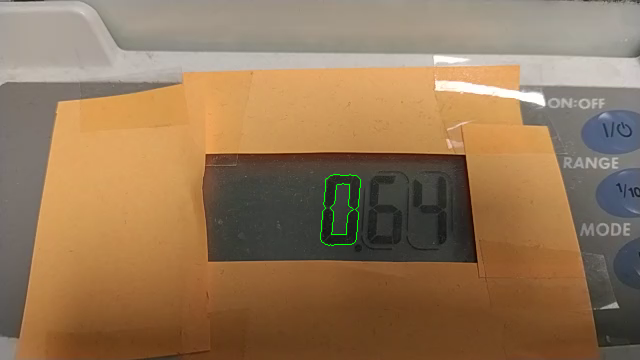

fr# 11104 time: 370.0207040197561 num: 0.0 certainty: 0.3079203029850997


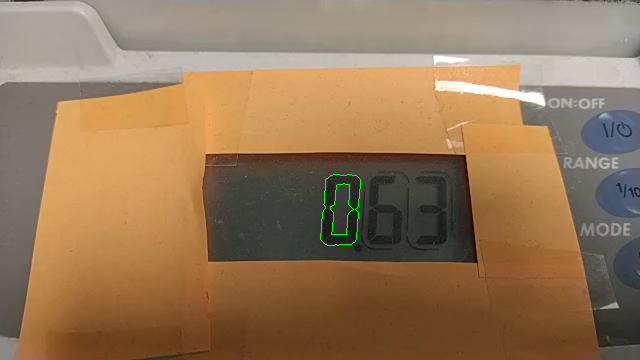

fr# 11404 time: 380.0176610808086 num: 0.0 certainty: 0.30785848936404964


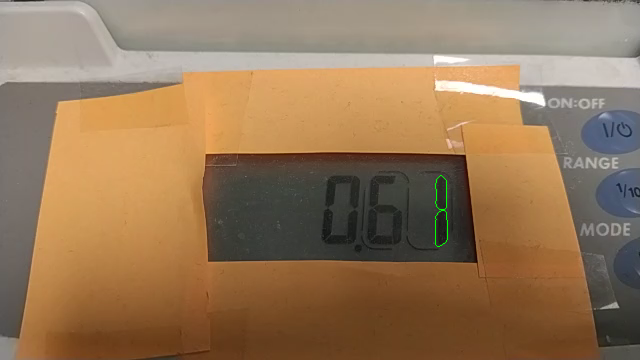

fr# 11704 time: 390.0146181418611 num: 0.01 certainty: 0.34055944055944054


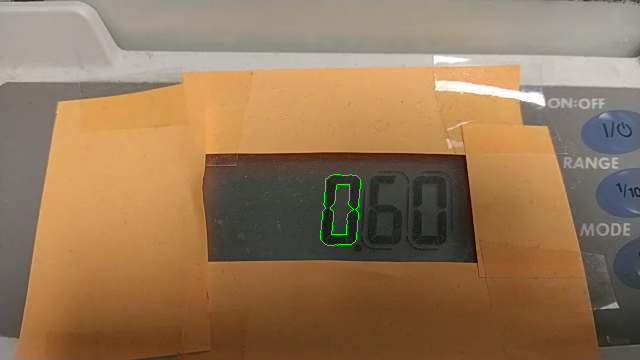

fr# 12004 time: 400.01157520291355 num: 0.0 certainty: 0.30987598716410275


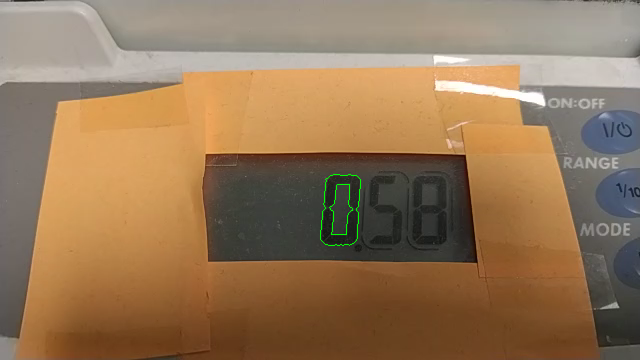

fr# 12304 time: 410.00853226396606 num: 0.0 certainty: 0.31160794524440055


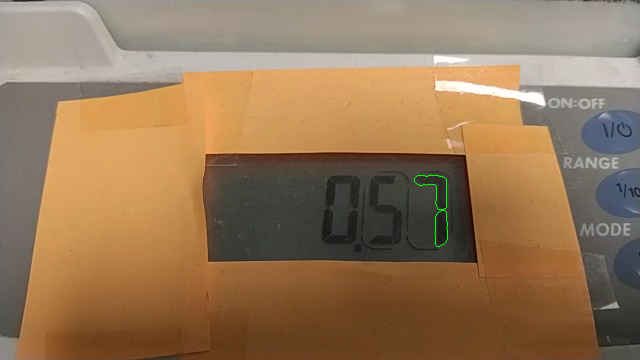

fr# 12604 time: 420.0054893250186 num: 0.07 certainty: 0.26458300282290403


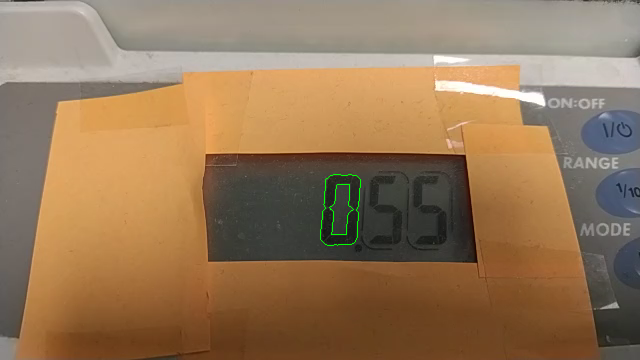

fr# 12904 time: 430.00244638607103 num: 0.0 certainty: 0.3106316564030263


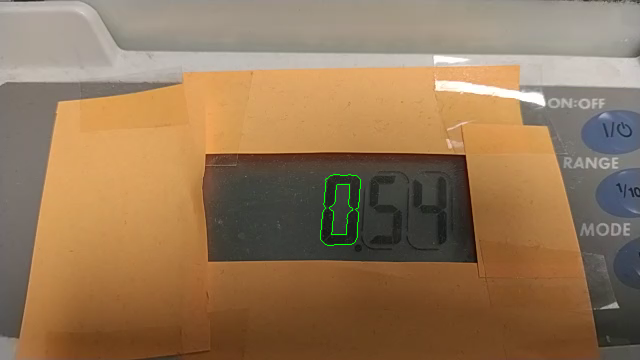

fr# 13205 time: 440.032726637327 num: 0.0 certainty: 0.3103283037302423


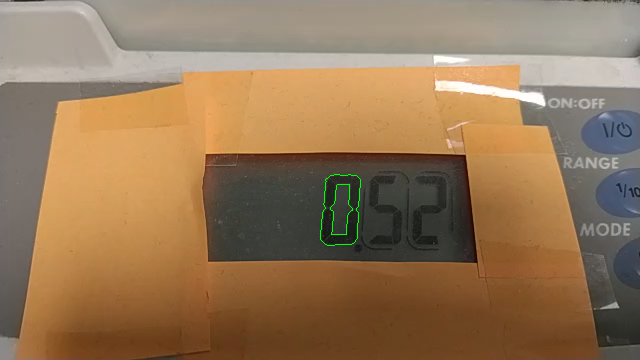

fr# 13505 time: 450.02968369837953 num: 0.0 certainty: 0.3091323065589514


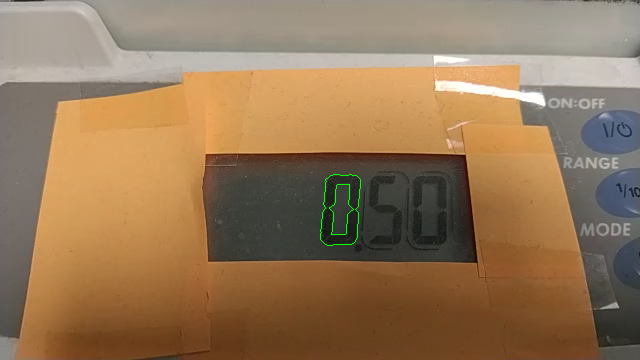

fr# 13805 time: 460.026640759432 num: 0.0 certainty: 0.30871839064537815


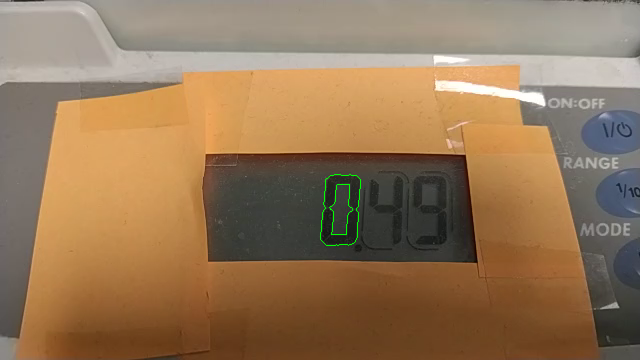

fr# 14105 time: 470.0235978204845 num: 0.0 certainty: 0.3127696524523548


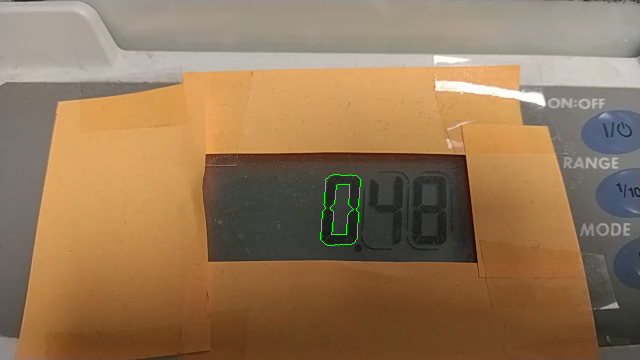

fr# 14405 time: 480.020554881537 num: 0.0 certainty: 0.30797983055262834


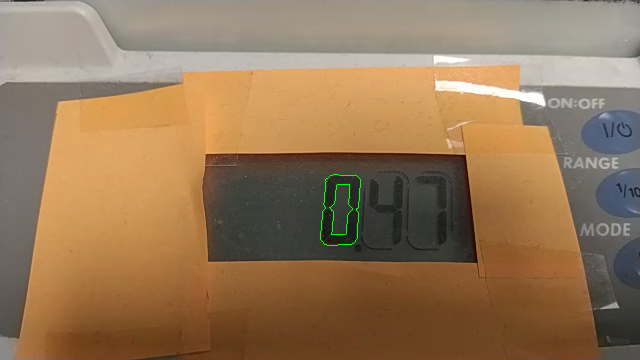

fr# 14705 time: 490.01751194258946 num: 0.0 certainty: 0.31005962531096937


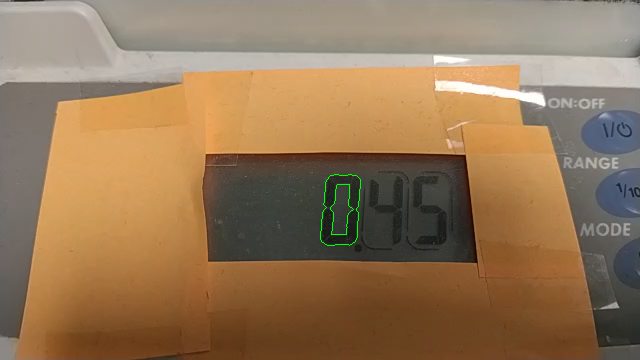

fr# 15005 time: 500.014469003642 num: 0.0 certainty: 0.30685993087961483


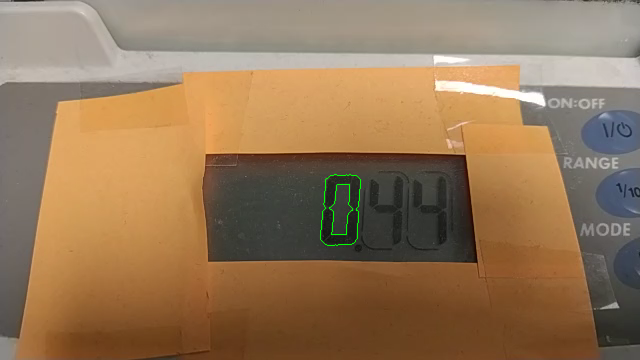

fr# 15305 time: 510.01142606469443 num: 0.0 certainty: 0.30841887383558514


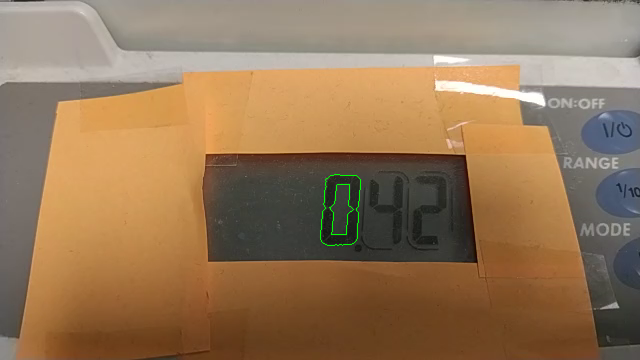

fr# 15605 time: 520.008383125747 num: 0.0 certainty: 0.3109034249768577


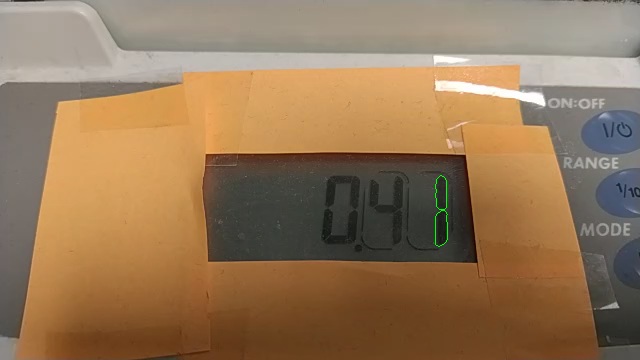

fr# 15905 time: 530.0053401867995 num: 0.01 certainty: 0.34615384615384615


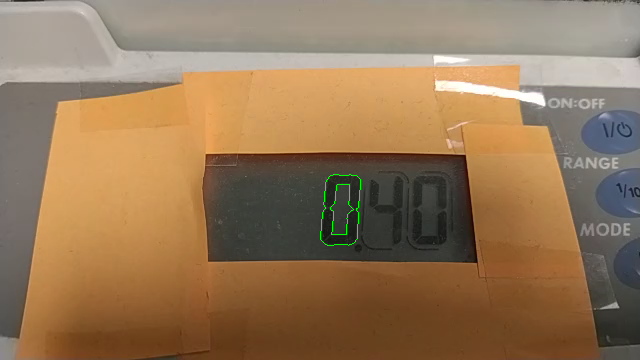

fr# 16205 time: 540.002297247852 num: 0.0 certainty: 0.3068875678354482


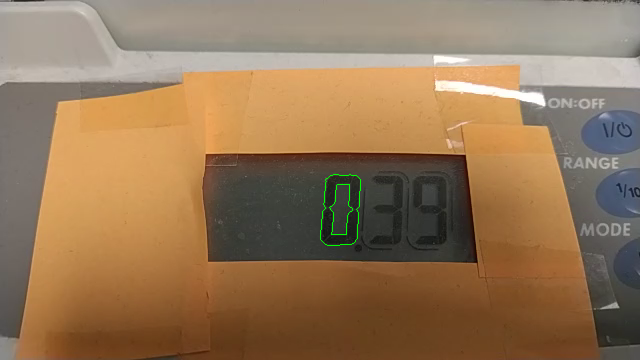

fr# 16506 time: 550.0325774991079 num: 0.0 certainty: 0.3116066605949901


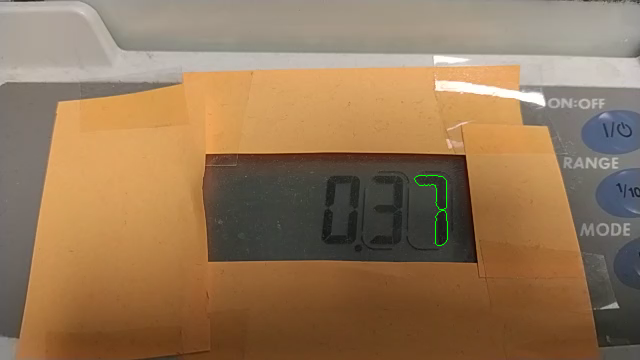

fr# 16806 time: 560.0295345601604 num: 0.07 certainty: 0.2731656935008021


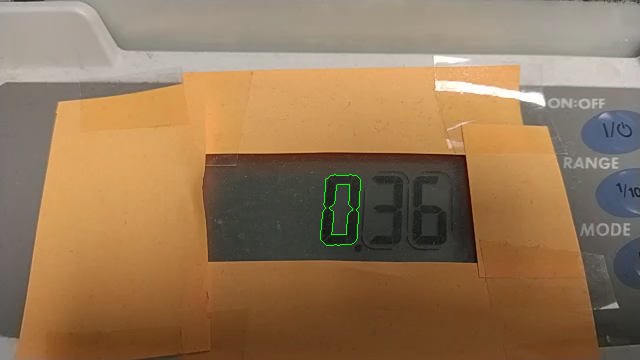

fr# 17106 time: 570.0264916212129 num: 0.0 certainty: 0.30491615507487946


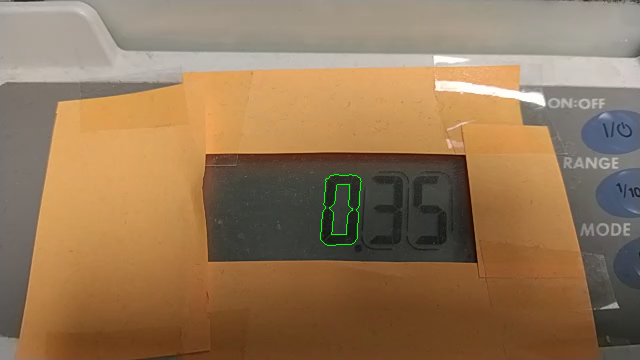

fr# 17406 time: 580.0234486822653 num: 0.0 certainty: 0.30163532294386597


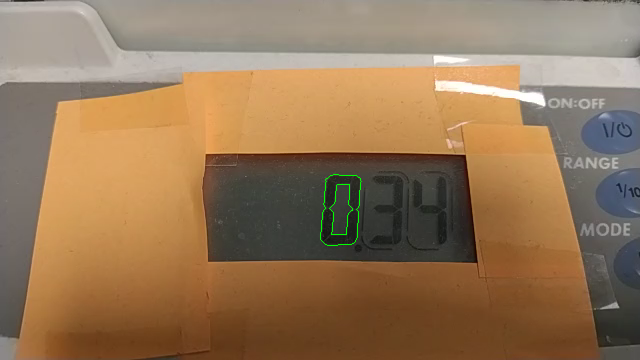

fr# 17706 time: 590.0204057433178 num: 0.0 certainty: 0.3016086535613217


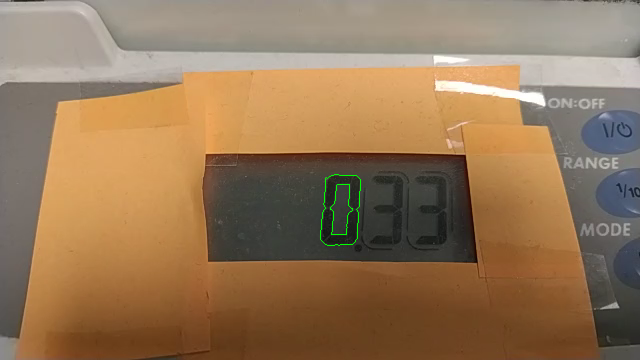

fr# 18006 time: 600.0173628043704 num: 0.0 certainty: 0.3036217883463493


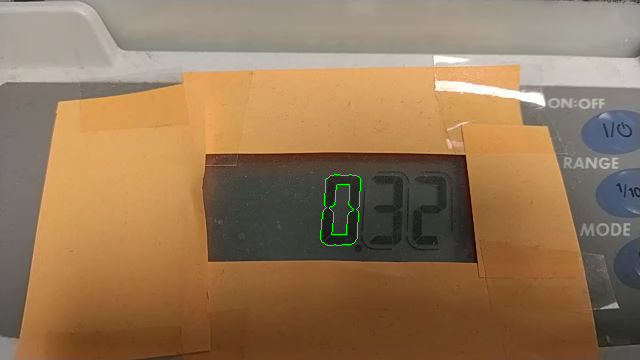

fr# 18306 time: 610.0143198654229 num: 0.0 certainty: 0.31360666495869516


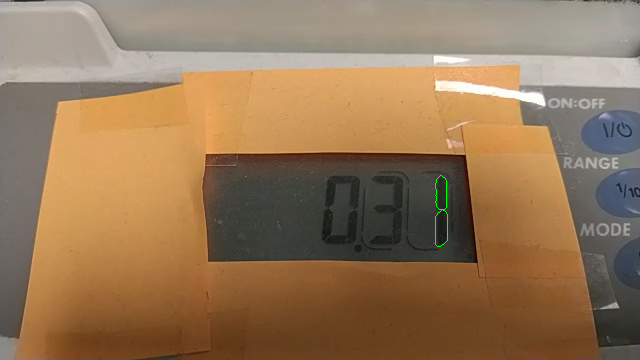

fr# 18606 time: 620.0112769264754 num: 0.01 certainty: 0.355944055944056


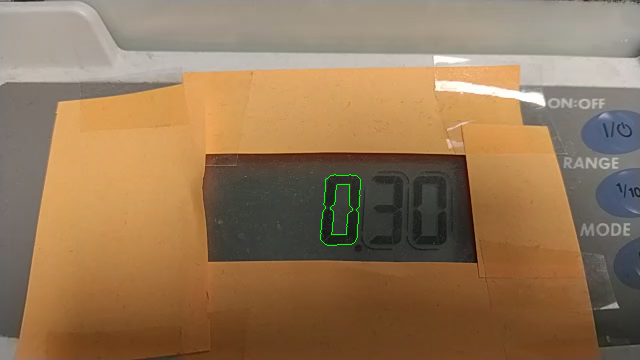

fr# 18906 time: 630.0082339875278 num: 0.0 certainty: 0.3060312403203628


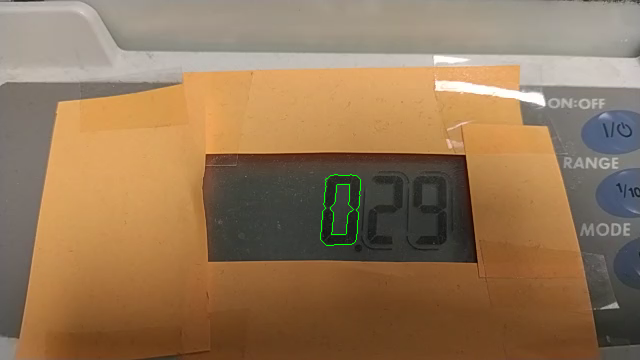

fr# 19206 time: 640.0051910485803 num: 0.0 certainty: 0.29684592128995696


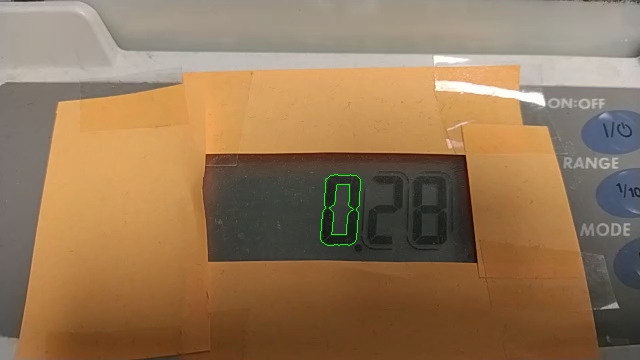

fr# 19506 time: 650.0021481096328 num: 0.0 certainty: 0.3085306681400362


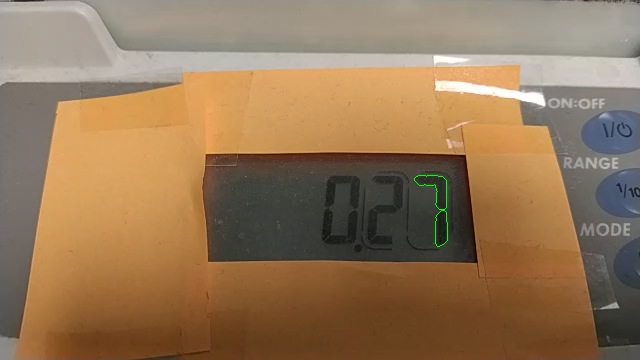

fr# 19807 time: 660.0324283608888 num: 0.07 certainty: 0.2526057716492443


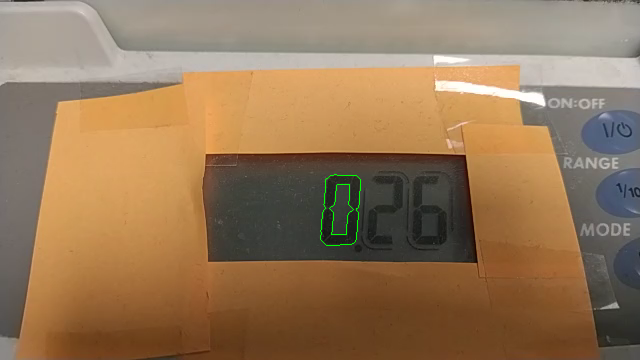

fr# 20107 time: 670.0293854219412 num: 0.0 certainty: 0.30770154860016785


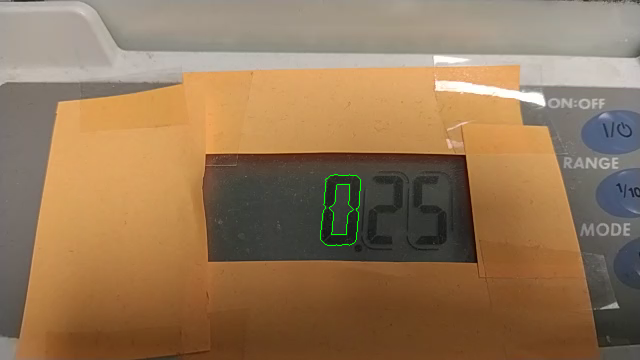

fr# 20407 time: 680.0263424829938 num: 0.0 certainty: 0.3089306763421226


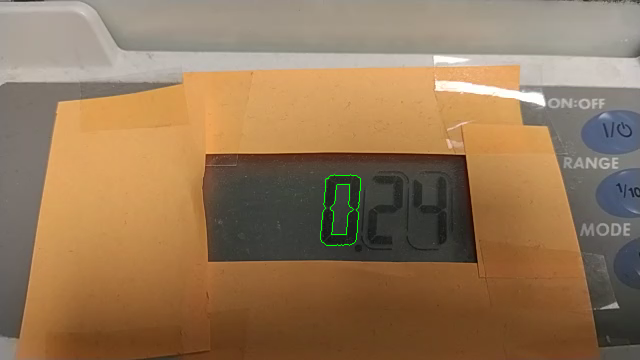

fr# 20707 time: 690.0232995440463 num: 0.0 certainty: 0.31016678166938405


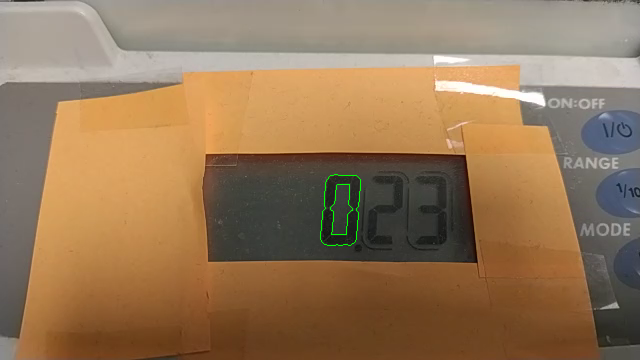

fr# 21007 time: 700.0202566050988 num: 0.0 certainty: 0.30953463556437455


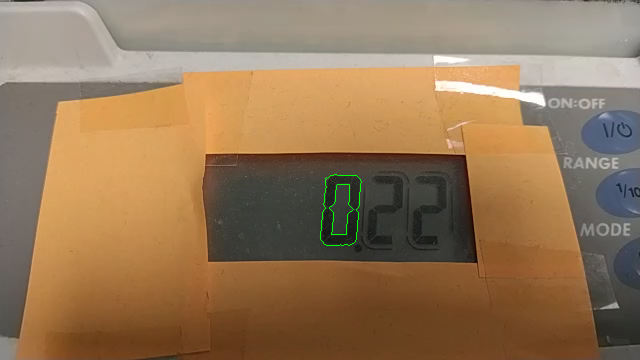

fr# 21307 time: 710.0172136661513 num: 0.0 certainty: 0.2837172819625368


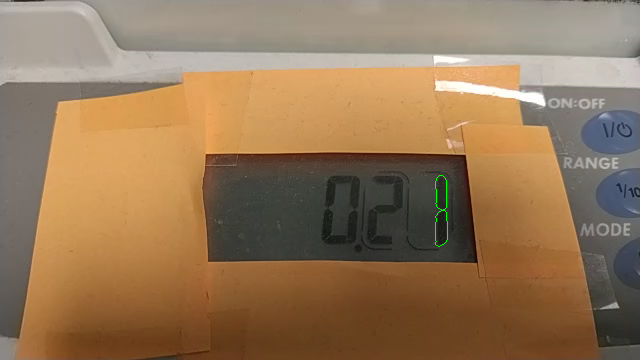

fr# 21607 time: 720.0141707272037 num: 0.01 certainty: 0.3419580419580419


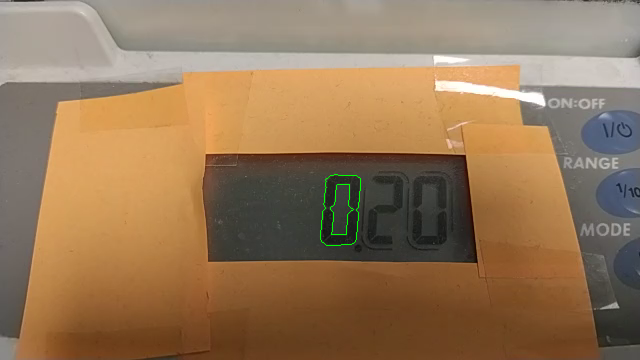

fr# 21907 time: 730.0111277882562 num: 0.0 certainty: 0.3100847376584234


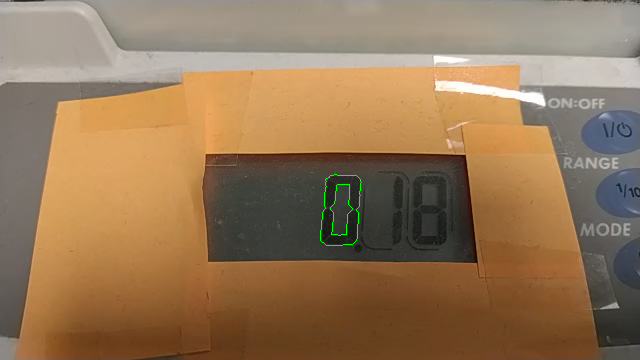

fr# 22207 time: 740.0080848493087 num: 0.0 certainty: 0.3042325384550117


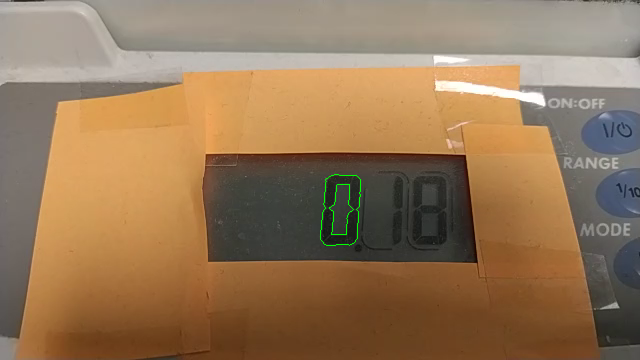

fr# 22507 time: 750.0050419103612 num: 0.0 certainty: 0.30935051178783163


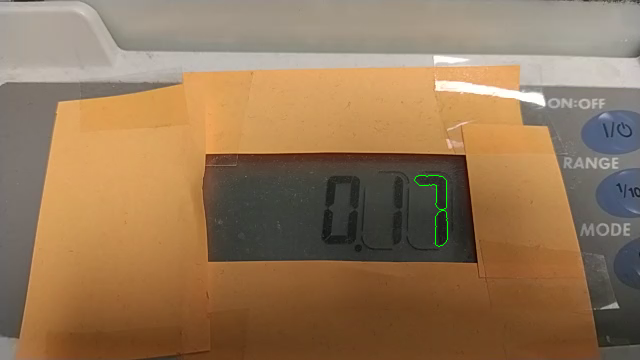

fr# 22807 time: 760.0019989714136 num: 0.07 certainty: 0.2753663083610194


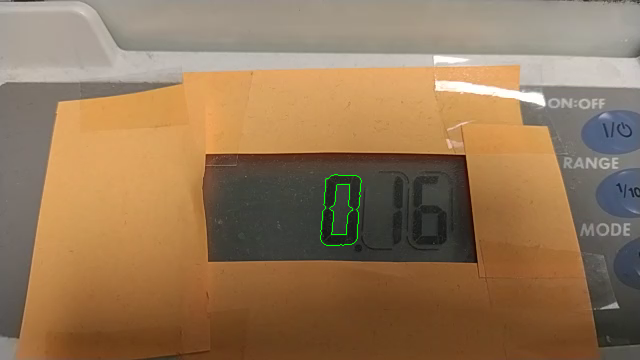

fr# 23108 time: 770.0322792226697 num: 0.0 certainty: 0.30801600067028323


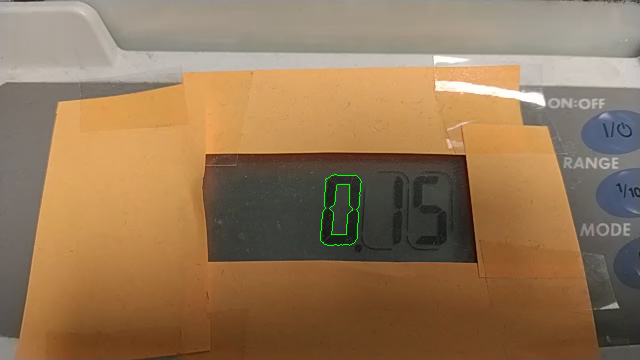

fr# 23408 time: 780.0292362837222 num: 0.0 certainty: 0.3014588886184701


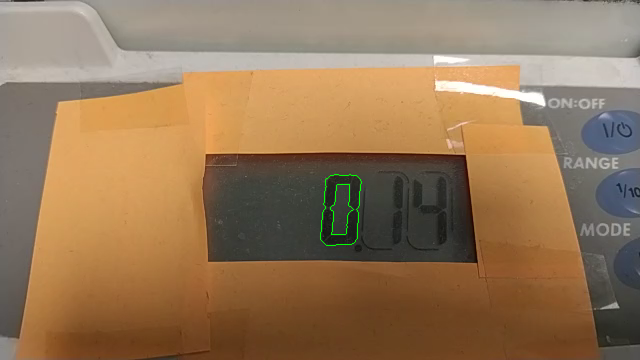

fr# 23708 time: 790.0261933447747 num: 0.0 certainty: 0.3031065854802139


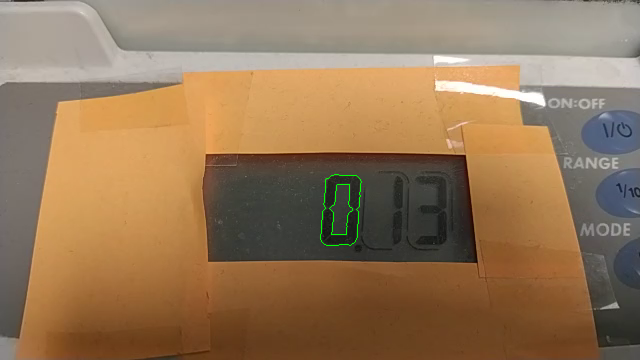

fr# 24008 time: 800.0231504058271 num: 0.0 certainty: 0.3049255560005676


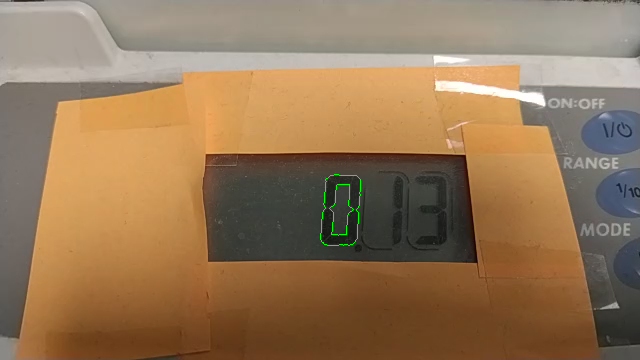

fr# 24308 time: 810.0201074668796 num: 0.0 certainty: 0.31213478518658516


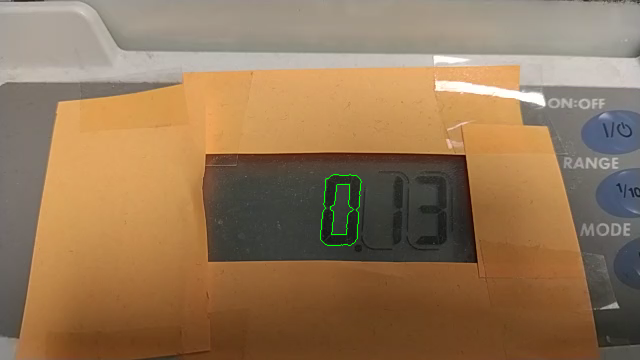

fr# 24608 time: 820.0170645279321 num: 0.0 certainty: 0.2914416882234468


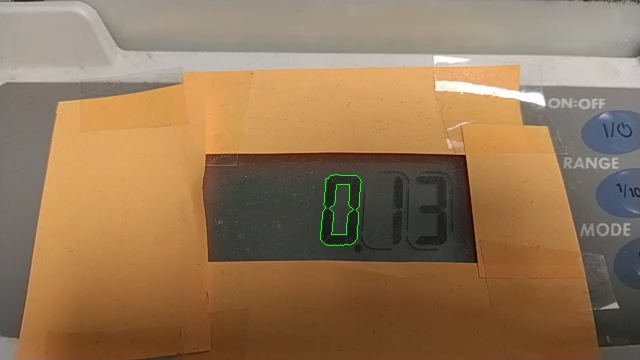

fr# 24908 time: 830.0140215889846 num: 0.0 certainty: 0.30487660995314286


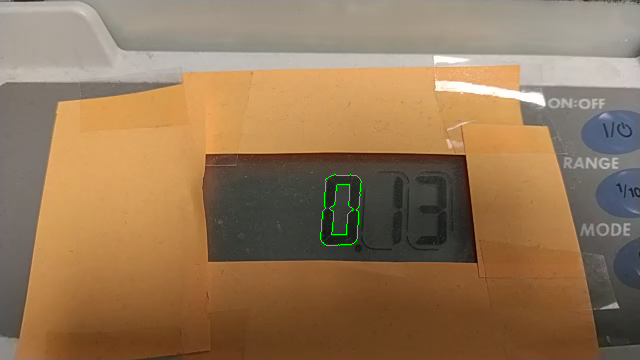

fr# 25208 time: 840.0109786500371 num: 0.0 certainty: 0.3057617849297607


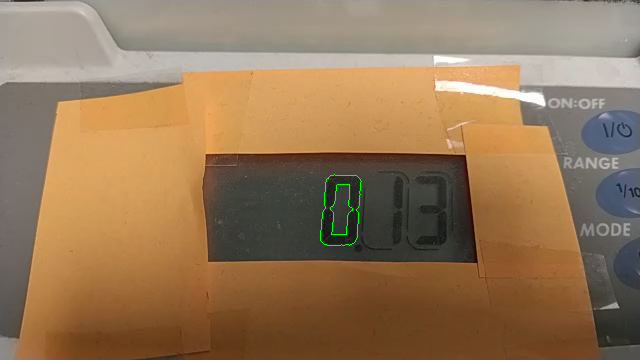

fr# 25508 time: 850.0079357110895 num: 0.0 certainty: 0.3031989898797306


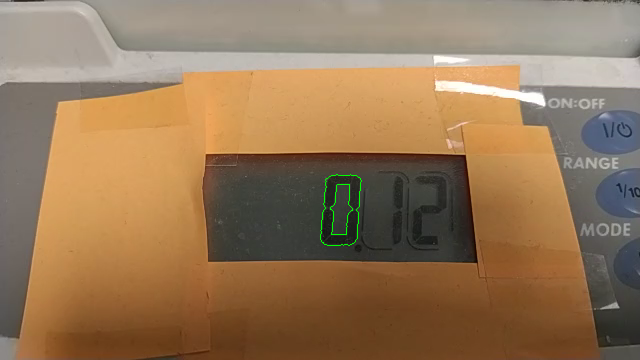

fr# 25808 time: 860.0048927721421 num: 0.0 certainty: 0.30375680643529046


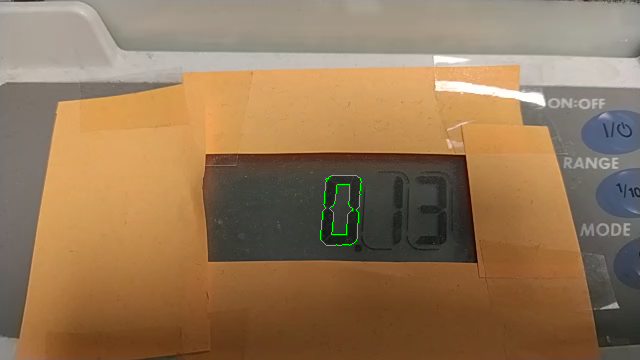

fr# 26108 time: 870.0018498331946 num: 0.0 certainty: 0.3218479058465841


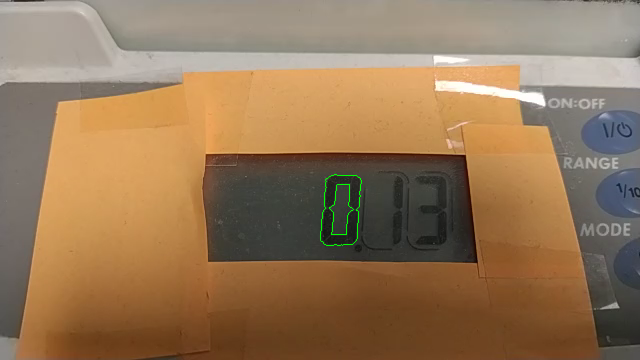

fr# 26409 time: 880.0321300844505 num: 0.0 certainty: 0.3068633112424073


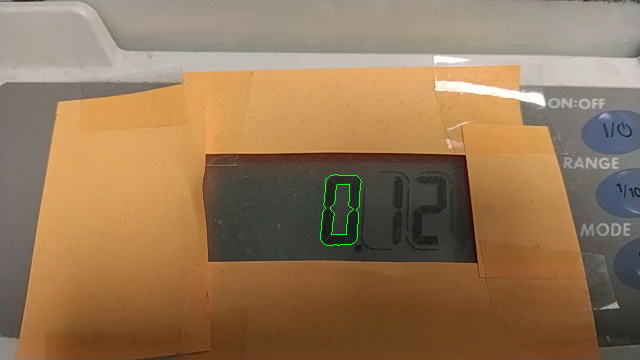

fr# 26709 time: 890.029087145503 num: 0.0 certainty: 0.3037060339159138


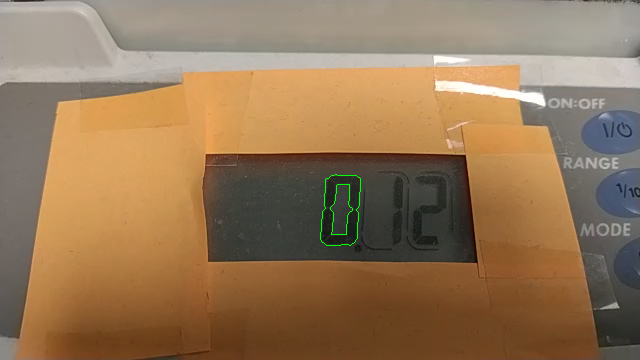

fr# 27009 time: 900.0260442065555 num: 0.0 certainty: 0.309068008911333


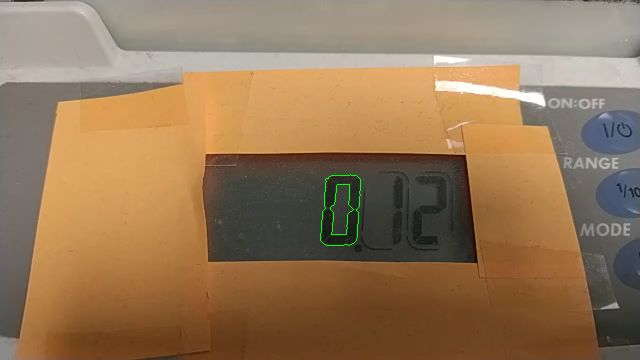

fr# 27309 time: 910.023001267608 num: 0.0 certainty: 0.3108014721106586


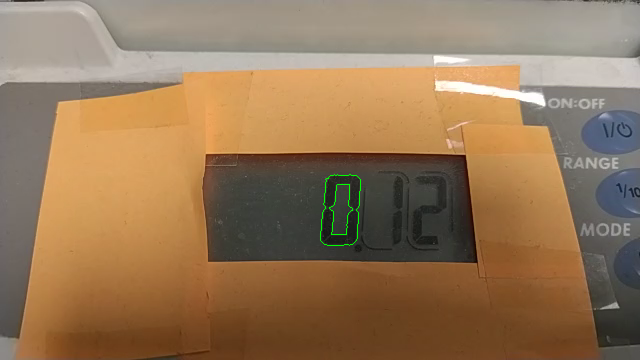

fr# 27609 time: 920.0199583286606 num: 0.0 certainty: 0.31352637286713375


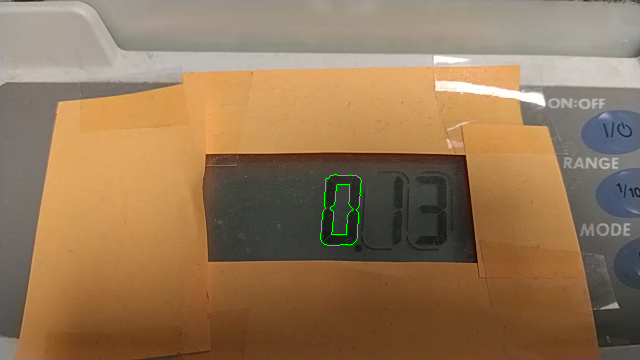

fr# 27909 time: 930.016915389713 num: 0.0 certainty: 0.30728632653295335


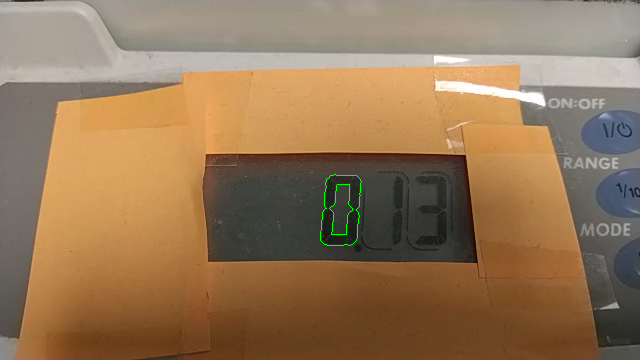

fr# 28209 time: 940.0138724507655 num: 0.0 certainty: 0.3075611634134879


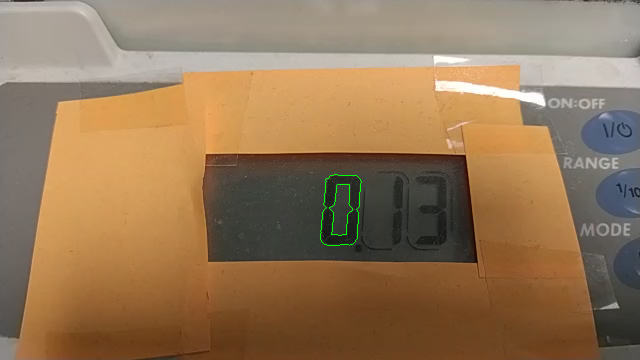

fr# 28509 time: 950.010829511818 num: 0.0 certainty: 0.30222630948793056


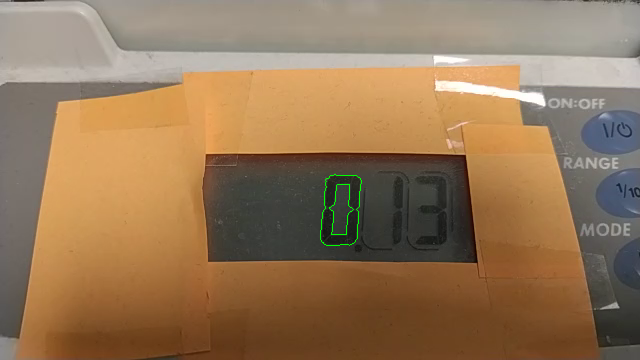

fr# 28809 time: 960.0077865728705 num: 0.0 certainty: 0.30576143892057533


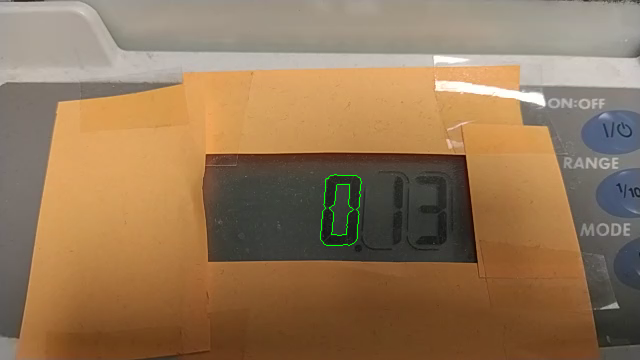

fr# 29109 time: 970.004743633923 num: 0.0 certainty: 0.30840633685233687


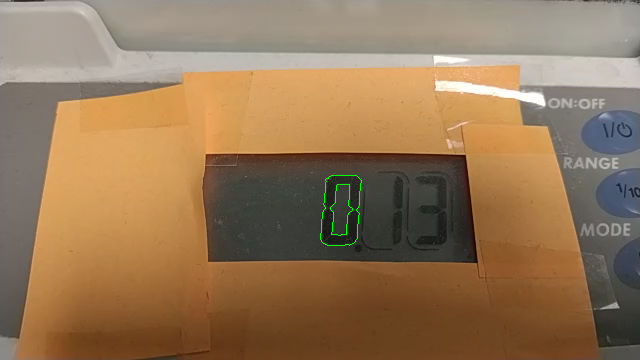

fr# 29409 time: 980.0017006949754 num: 0.0 certainty: 0.3244702583761788


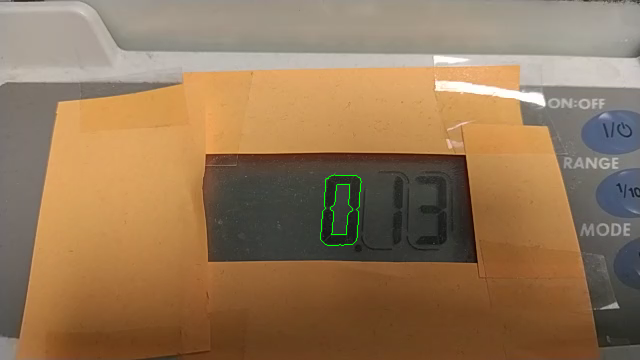

fr# 29710 time: 990.0319809462314 num: 0.0 certainty: 0.28840568638117364


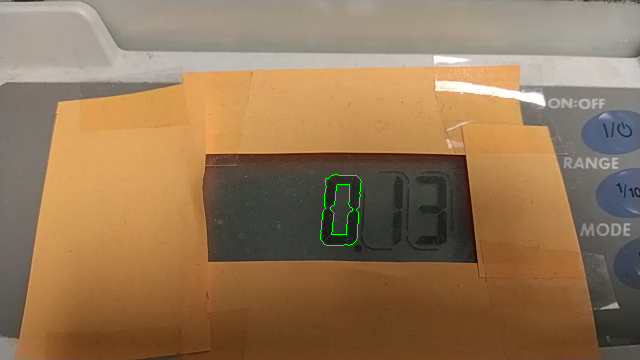

fr# 30010 time: 1000.028938007284 num: 0.0 certainty: 0.3061907634106327


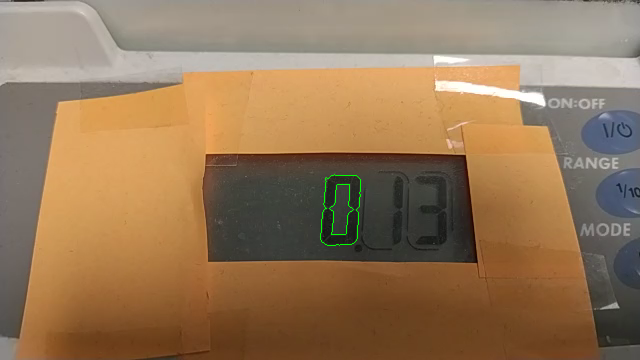

fr# 30310 time: 1010.0258950683365 num: 0.0 certainty: 0.29872446156415994


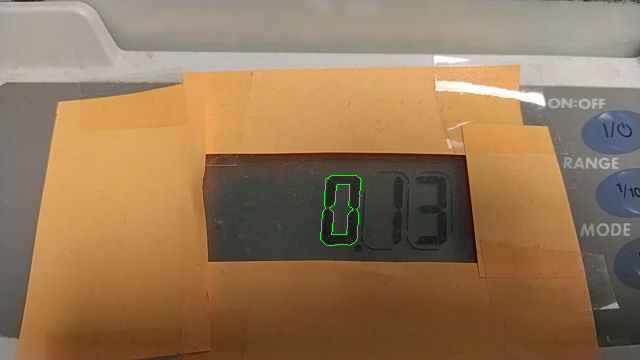

fr# 30610 time: 1020.0228521293889 num: 0.0 certainty: 0.3201423252012861


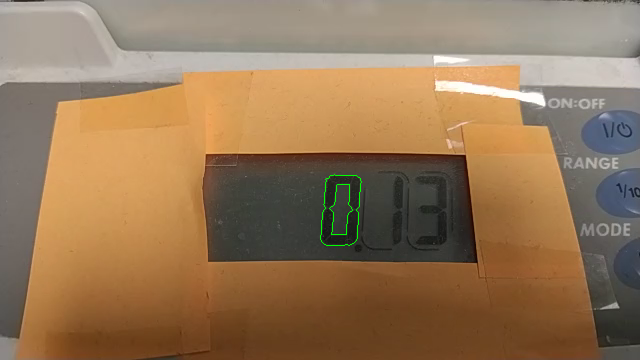

fr# 30910 time: 1030.0198091904415 num: 0.0 certainty: 0.30628826780718577


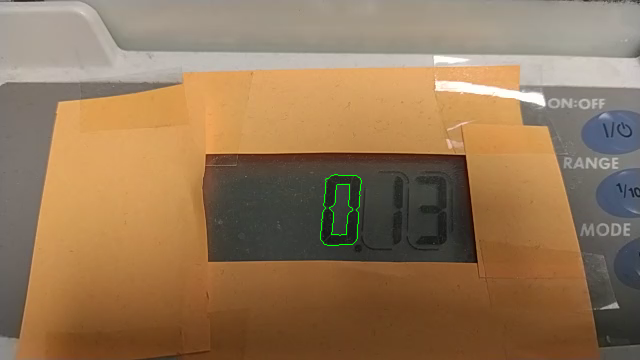

fr# 31210 time: 1040.016766251494 num: 0.0 certainty: 0.30406741786861596


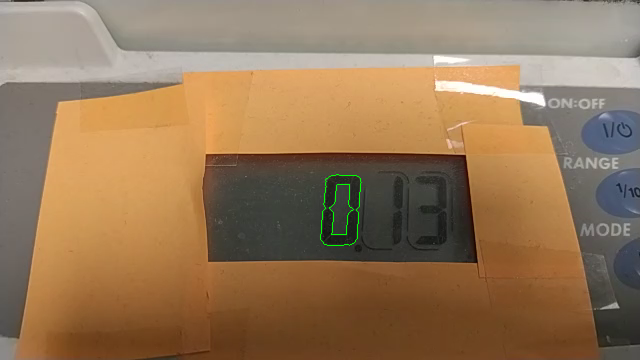

fr# 31510 time: 1050.0137233125463 num: 0.0 certainty: 0.3041748771239047


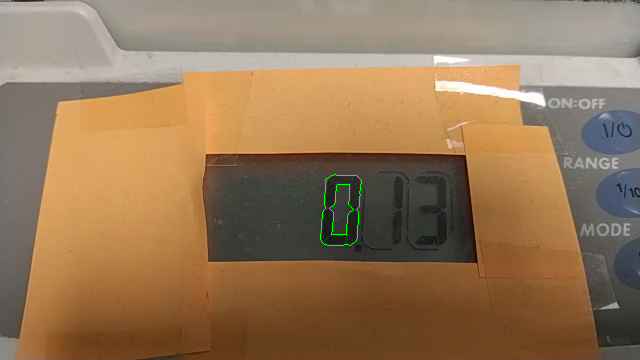

fr# 31810 time: 1060.010680373599 num: 0.0 certainty: 0.30857967060883645


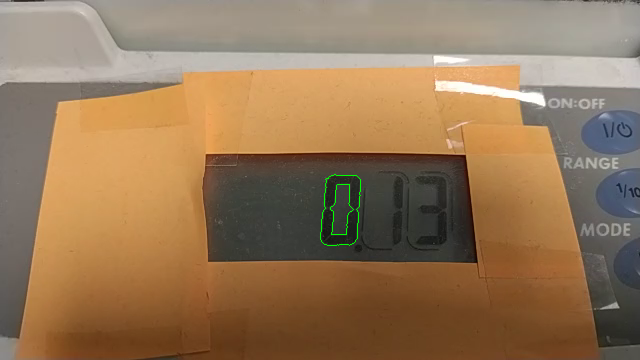

fr# 32110 time: 1070.0076374346513 num: 0.0 certainty: 0.30350405536942077


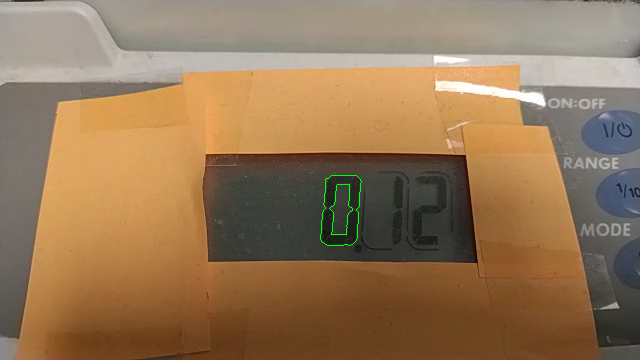

fr# 32410 time: 1080.004594495704 num: 0.0 certainty: 0.3246102870697186


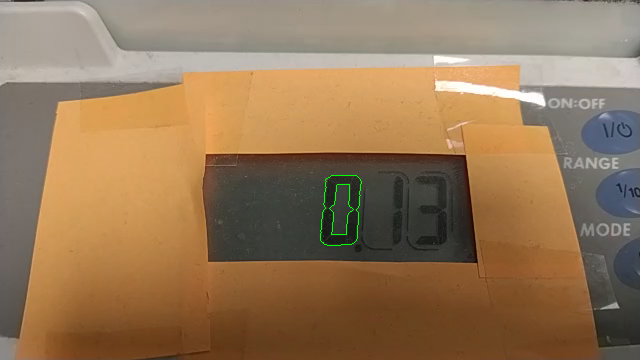

fr# 32710 time: 1090.0015515567563 num: 0.0 certainty: 0.324099794231785


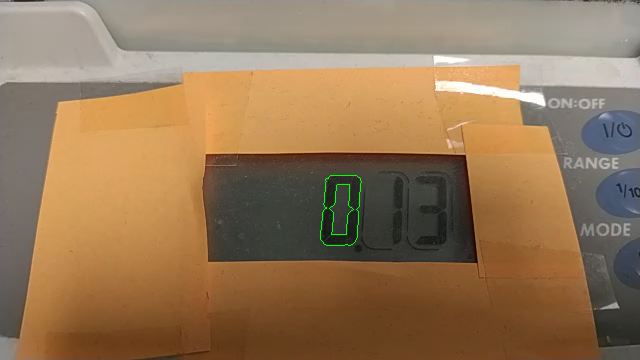

fr# 33011 time: 1100.0318318080124 num: 0.0 certainty: 0.3278564995638709


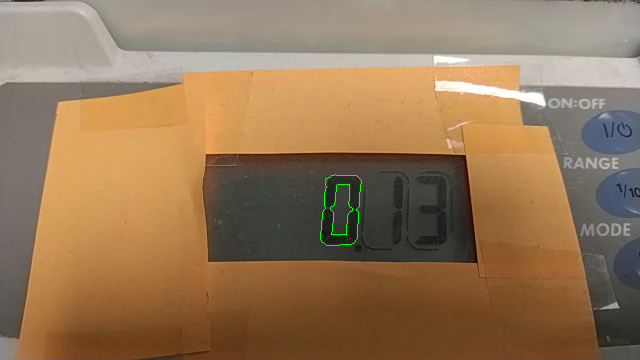

fr# 33311 time: 1110.0287888690648 num: 0.0 certainty: 0.30142270450831254


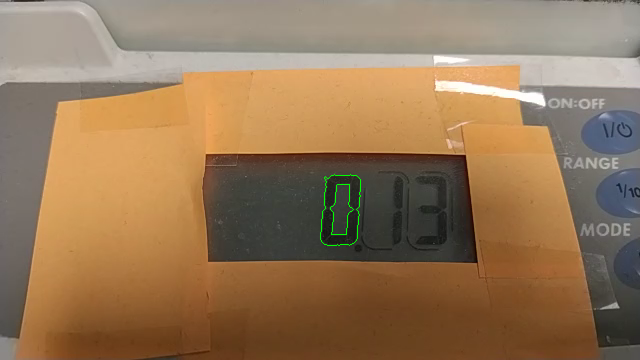

fr# 33611 time: 1120.0257459301172 num: 0.0 certainty: 0.29994522908373067


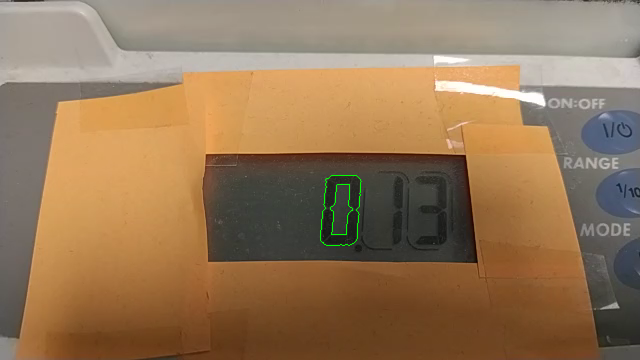

fr# 33911 time: 1130.0227029911698 num: 0.0 certainty: 0.3249162486869825


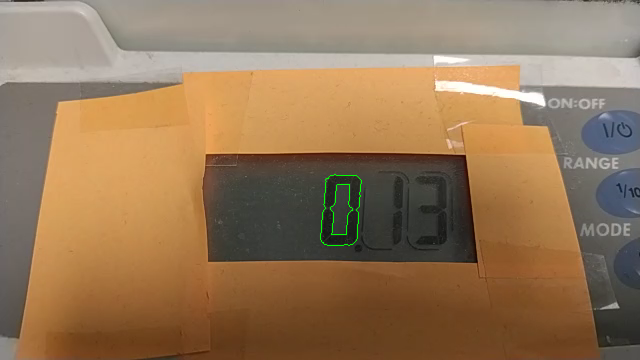

fr# 34211 time: 1140.0196600522222 num: 0.0 certainty: 0.30967395813783793


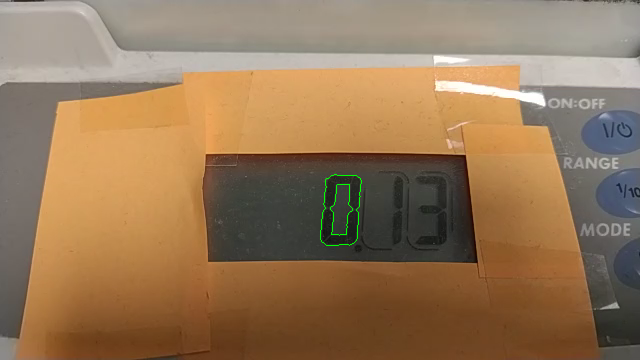

fr# 34511 time: 1150.0166171132748 num: 0.0 certainty: 0.30527253412161004


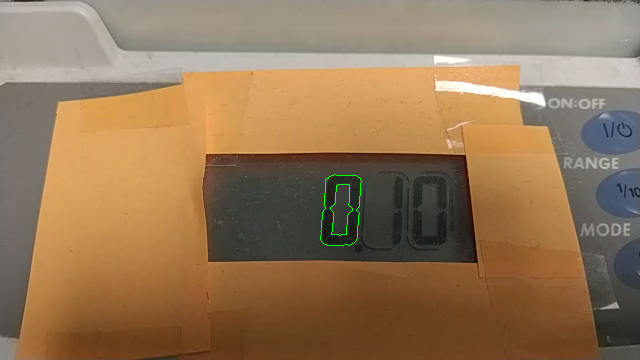

fr# 34811 time: 1160.0135741743272 num: 0.0 certainty: 0.3072978816974902


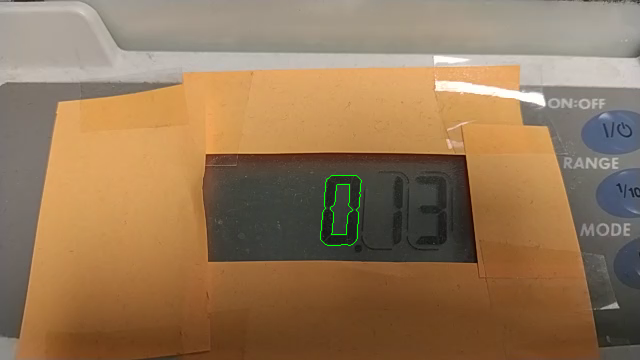

fr# 35111 time: 1170.0105312353796 num: 0.0 certainty: 0.3231504718605585


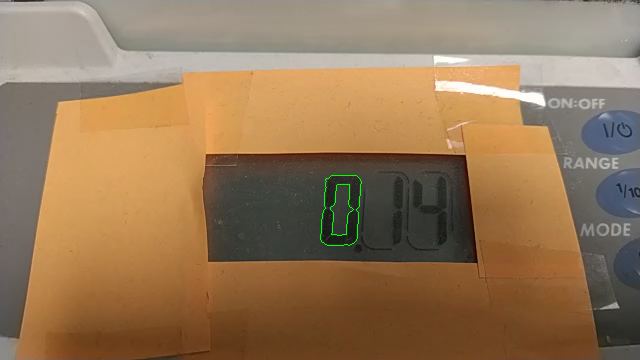

fr# 35411 time: 1180.0074882964323 num: 0.0 certainty: 0.325773167434786


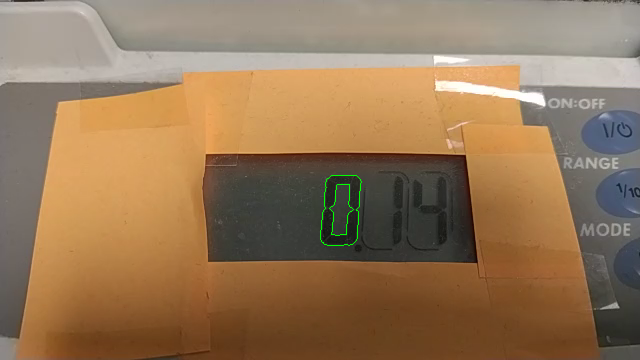

fr# 35711 time: 1190.0044453574847 num: 0.0 certainty: 0.32306945480621


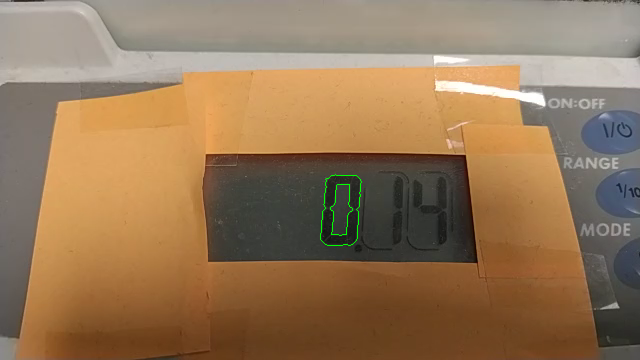

fr# 36011 time: 1200.0014024185373 num: 0.0 certainty: 0.3015871496203339


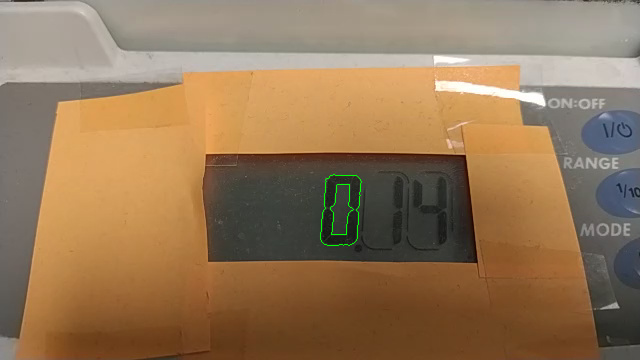

fr# 36312 time: 1210.031682669793 num: 0.0 certainty: 0.30505559250669395


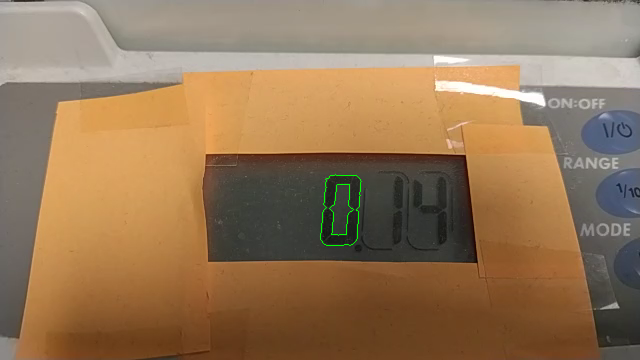

fr# 36612 time: 1220.0286397308457 num: 0.0 certainty: 0.3047717566921695


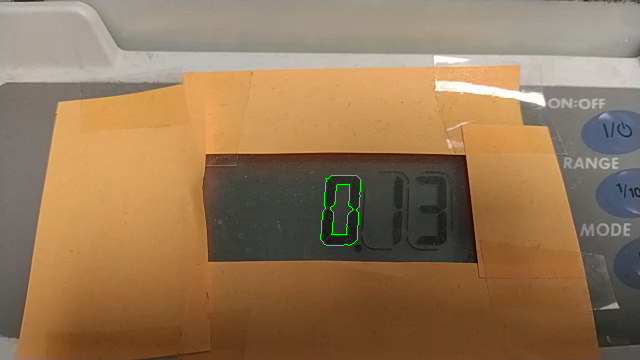

fr# 36912 time: 1230.0255967918981 num: 0.0 certainty: 0.3289875196809512


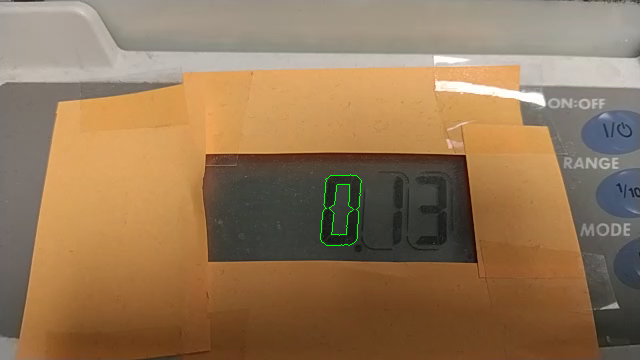

fr# 37212 time: 1240.0225538529508 num: 0.0 certainty: 0.3050258504623419


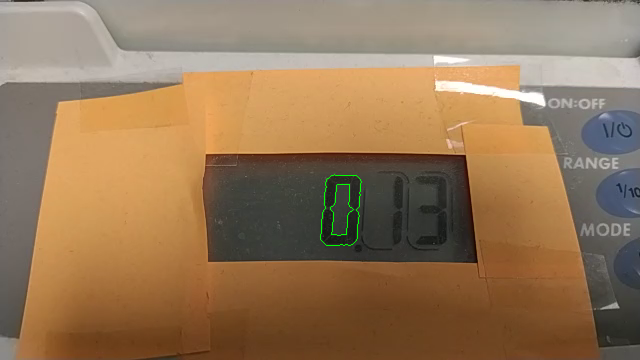

fr# 37512 time: 1250.0195109140031 num: 0.0 certainty: 0.2996555697189172


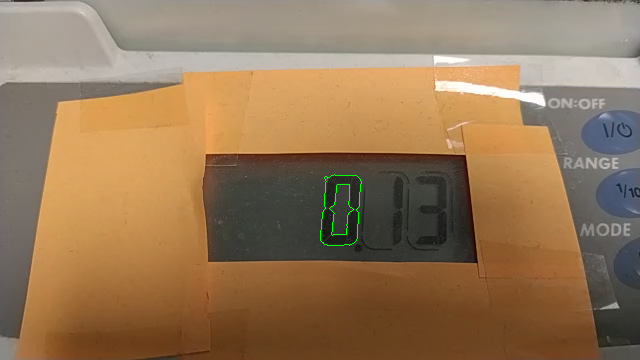

fr# 37812 time: 1260.0164679750555 num: 0.0 certainty: 0.2911640726283065


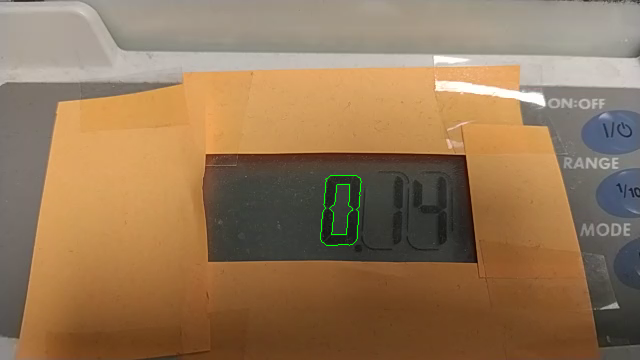

fr# 38112 time: 1270.0134250361082 num: 0.0 certainty: 0.32346856804757945


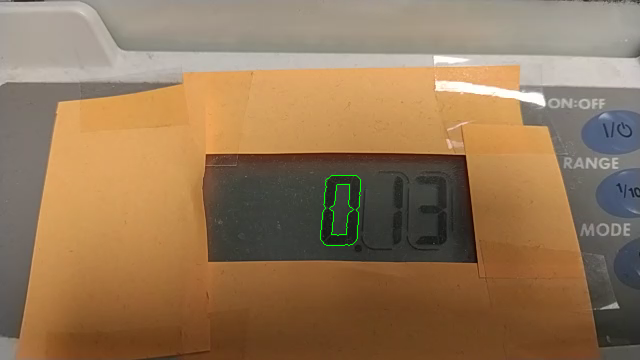

fr# 38412 time: 1280.0103820971606 num: 0.0 certainty: 0.3311925981565697


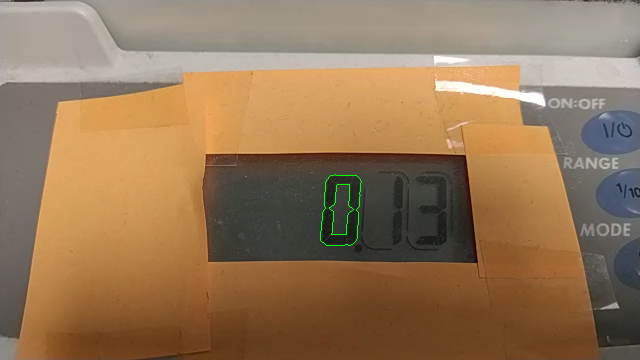

fr# 38712 time: 1290.0073391582132 num: 0.0 certainty: 0.3071978372898298


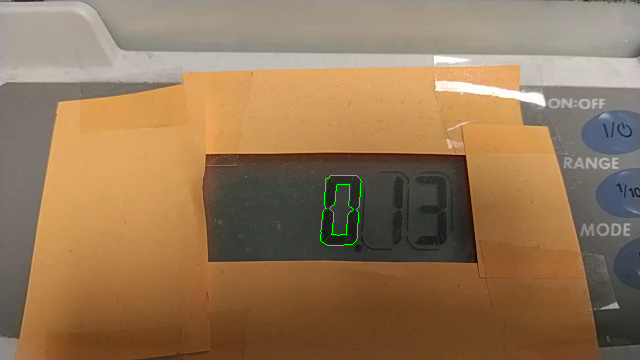

fr# 39012 time: 1300.0042962192656 num: 0.0 certainty: 0.3250124393629338


In [ ]:
def trans_break_h(p):
  return np.power(p,3,out=p,where=np.array([True,False]))
def trans_break_v(p):
  return np.power(p,3,out=p,where=np.array([False,True]))

def get_numbers(frame):
  num_forest_naive = ColorImage(frame).contour_forest().numbers_forest(3.5,7)
  vgrps = []
  dist = 50
  while len(vgrps) < 3 and dist < 3000:
    dist += 10
    vgrps = list(num_forest_naive.dist_groups(trans_break_h,dist))

  num_forest = max(vgrps,key=len)
  nums = num_forest.dist_groups(trans_break_v,50)

  # The following line shows images.
  num_forest.show()

  ret = 0
  min_cert = float('inf')
  for  n in nums:
    ret *= 10
    n,cert = to_number(n)
    if cert <= 0: continue
    min_cert = min(cert,min_cert)
    ret += n

  return (min_cert,ret/100)

if RELEASE:
  with open (VIDEO_PATH + ".csv",mode='w') as fd:
    next_frame_after = 0
    fd.write("frame,second,reading\n")
    for i,(t,frame) in enumerate(video_frames(VIDEO_PATH)):
      if t < next_frame_after: continue
      next_frame_after += 10
      cert,n = get_numbers(frame)
      print("fr#",i,"time:",t,"num:",n,"certainty:",cert)
      fd.write("%d,%f,%f\n" % (i,t,n))